# Spotify Song & Genre Analysis - 8
> Elif Aydın 28061

> Serra Tuncel ?????

> Okan Sarp Kaya 26546




## Introduction


In this project, we are given a dataset which has many songs,artists,genres and the features. We are going to analyze how the features of different genres change within the year interval 1920-2020. In this step, we are going to make Exploratory Data Analysis which will be consists of 4 sections. Section1: Visualizations of Descriptive Statistics. Section2: Visualizations of Aggregated Forms Based on Features. Section3: Analysis of the Most Popular Artists and Songs. Section4: How Songs of Different Genres Change Over Time. In the next steps, we will build a simple recommendation model based on our analysis from the dataset.


#Exploratory Data Analysis

### Tasks and imports

In [41]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px 
import matplotlib as mpl
from sklearn.decomposition import PCA

In [43]:
from google.colab import drive
from os.path import join
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Read File and General statistics from the datasets

In [44]:
from google.colab import drive
from os.path import join
drive.mount('/content/drive')
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px 
import matplotlib as mpl
from sklearn.decomposition import PCA
filename = "data.csv"  
path = "./drive/My Drive/CS210ProjectDatas"
df = pd.read_csv(join(path, filename))
df.head()
#Each row represents a single track, 
#each column represents a field of the track (audio features and identifiers)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,valence,year
0,0.991000,['Mamie Smith'],0.598,168333,0.224,0,0cS0A1fUEUd1EW3FcF8AEI,0.000522,5,0.3790,-12.628,0,Keep A Song In Your Soul,12,1920,0.0936,149.976,0.6340,1920
1,0.643000,"[""Screamin' Jay Hawkins""]",0.852,150200,0.517,0,0hbkKFIJm7Z05H8Zl9w30f,0.026400,5,0.0809,-7.261,0,I Put A Spell On You,7,1920-01-05,0.0534,86.889,0.9500,1920
2,0.993000,['Mamie Smith'],0.647,163827,0.186,0,11m7laMUgmOKqI3oYzuhne,0.000018,0,0.5190,-12.098,1,Golfing Papa,4,1920,0.1740,97.600,0.6890,1920
3,0.000173,['Oscar Velazquez'],0.730,422087,0.798,0,19Lc5SfJJ5O1oaxY0fpwfh,0.801000,2,0.1280,-7.311,1,True House Music - Xavier Santos & Carlos Gomi...,17,1920-01-01,0.0425,127.997,0.0422,1920
4,0.295000,['Mixe'],0.704,165224,0.707,1,2hJjbsLCytGsnAHfdsLejp,0.000246,10,0.4020,-6.036,0,Xuniverxe,2,1920-10-01,0.0768,122.076,0.2990,1920


**Information of columns for data_csv**

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174389 entries, 0 to 174388
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   acousticness      174389 non-null  float64
 1   artists           174389 non-null  object 
 2   danceability      174389 non-null  float64
 3   duration_ms       174389 non-null  int64  
 4   energy            174389 non-null  float64
 5   explicit          174389 non-null  int64  
 6   id                174389 non-null  object 
 7   instrumentalness  174389 non-null  float64
 8   key               174389 non-null  int64  
 9   liveness          174389 non-null  float64
 10  loudness          174389 non-null  float64
 11  mode              174389 non-null  int64  
 12  name              174389 non-null  object 
 13  popularity        174389 non-null  int64  
 14  release_date      174389 non-null  object 
 15  speechiness       174389 non-null  float64
 16  tempo             17

**Summary statistics for data_csv**

In [ ]:
df.describe() 

,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo,valence,year
count,174389.000000,174389.000000,1.743890e+05,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000
mean,0.499228,0.536758,2.328100e+05,0.482721,0.068135,0.197252,5.205305,0.211123,-11.750865,0.702384,25.693381,0.105729,117.006500,0.524533,1977.061764
std,0.379936,0.176025,1.483958e+05,0.272685,0.251978,0.334574,3.518292,0.180493,5.691591,0.457211,21.872740,0.182260,30.254178,0.264477,26.907950
min,0.000000,0.000000,4.937000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1920.000000
25%,0.087700,0.414000,1.661330e+05,0.249000,0.000000,0.000000,2.000000,0.099200,-14.908000,0.000000,1.000000,0.035200,93.931000,0.311000,1955.000000
50%,0.517000,0.548000,2.057870e+05,0.465000,0.000000,0.000524,5.000000,0.138000,-10.836000,1.000000,25.000000,0.045500,115.816000,0.536000,1977.000000
75%,0.895000,0.669000,2.657200e+05,0.711000,0.000000,0.252000,8.000000,0.270000,-7.499000,1.000000,42.000000,0.076300,135.011000,0.743000,1999.000000
max,0.996000,0.988000,5.338302e+06,1.000000,1.000000,1.000000,11.000000,1.000000,3.855000,1.000000,100.000000,0.971000,243.507000,1.000000,2021.000000


In [ ]:
filename2 = "data_by_artist.csv"  
path = "./drive/My Drive/CS210ProjectDatas"
df2 = pd.read_csv(join(path, filename2))
df2.head()
#This file contains the audio features of each artist, resulted from the aggregation. 
#The rows represent different artists, columns represent different audio features

,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count
0,"""Cats"" 1981 Original London Cast",0.598500,0.470100,267072.000000,0.376203,0.010261,0.283050,-14.434300,0.209150,114.128800,0.358320,38.200000,5,1,10
1,"""Cats"" 1983 Broadway Cast",0.862538,0.441731,287280.000000,0.406808,0.081158,0.315215,-10.690000,0.176212,103.044154,0.268865,31.538462,5,1,26
2,"""Fiddler On The Roof” Motion Picture Chorus",0.856571,0.348286,328920.000000,0.286571,0.024593,0.325786,-15.230714,0.118514,77.375857,0.354857,34.571429,0,1,7
3,"""Fiddler On The Roof” Motion Picture Orchestra",0.884926,0.425074,262890.962963,0.245770,0.073587,0.275481,-15.639370,0.123200,88.667630,0.372030,34.407407,0,1,27
4,"""Joseph And The Amazing Technicolor Dreamcoat""...",0.510714,0.467143,270436.142857,0.488286,0.009400,0.195000,-10.236714,0.098543,122.835857,0.482286,42.000000,5,1,7


**Information of Columns for data_by_artists**

In [ ]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32539 entries, 0 to 32538
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   artists           32539 non-null  object 
 1   acousticness      32539 non-null  float64
 2   danceability      32539 non-null  float64
 3   duration_ms       32539 non-null  float64
 4   energy            32539 non-null  float64
 5   instrumentalness  32539 non-null  float64
 6   liveness          32539 non-null  float64
 7   loudness          32539 non-null  float64
 8   speechiness       32539 non-null  float64
 9   tempo             32539 non-null  float64
 10  valence           32539 non-null  float64
 11  popularity        32539 non-null  float64
 12  key               32539 non-null  int64  
 13  mode              32539 non-null  int64  
 14  count             32539 non-null  int64  
dtypes: float64(11), int64(3), object(1)
memory usage: 3.7+ MB


**Summary statistics for data_by_artists**

In [ ]:
df2.describe()

,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count
count,32539.000000,32539.000000,3.253900e+04,32539.000000,32539.000000,32539.000000,32539.000000,32539.000000,32539.000000,32539.000000,32539.000000,32539.000000,32539.000000,32539.000000
mean,0.455682,0.552737,2.485982e+05,0.525908,0.233281,0.209035,-11.008171,0.092047,117.433745,0.498812,24.473452,5.459787,0.734903,12.561818
std,0.383678,0.176445,1.581808e+05,0.267402,0.334487,0.151781,5.568630,0.111257,24.467506,0.247154,23.021041,3.473653,0.441392,52.407821
min,0.000000,0.000000,8.042000e+03,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,0.055155,0.436487,1.804616e+05,0.299000,0.000012,0.109000,-13.792500,0.039700,100.983500,0.305792,0.000000,2.000000,0.000000,2.000000
50%,0.391833,0.563000,2.215070e+05,0.537375,0.009550,0.162000,-9.887000,0.052822,118.779000,0.506000,22.666667,6.000000,1.000000,2.000000
75%,0.876000,0.684500,2.815870e+05,0.747039,0.451149,0.259500,-6.944500,0.090800,130.552000,0.691500,43.141941,8.000000,1.000000,7.000000
max,0.996000,0.987000,4.696690e+06,1.000000,1.000000,0.986000,3.367000,0.971000,219.833000,0.997000,94.000000,11.000000,1.000000,3179.000000


In [ ]:
filename3 = "data_by_genres.csv"  
path = "./drive/My Drive/CS210ProjectDatas" 
df3 = pd.read_csv(join(path, filename3))
df3.head()
#This file contains the audio features of each genre. 
#The rows represent different genres, and the columns represent different audio features.

,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode
0,21st century classical,0.754600,0.284100,3.525932e+05,0.159580,0.484374,0.168580,-22.153400,0.062060,91.351000,0.143380,6.600000,4,1
1,432hz,0.485515,0.312000,1.047430e+06,0.391678,0.477250,0.265940,-18.131267,0.071717,118.900933,0.236483,41.200000,11,1
2,8-bit,0.028900,0.673000,1.334540e+05,0.950000,0.630000,0.069000,-7.899000,0.292000,192.816000,0.997000,0.000000,5,1
3,[],0.535793,0.546937,2.495312e+05,0.485430,0.278442,0.220970,-11.624754,0.101511,116.068980,0.486361,12.350770,7,1
4,a cappella,0.694276,0.516172,2.018391e+05,0.330533,0.036080,0.222983,-12.656547,0.083627,105.506031,0.454077,39.086248,7,1


**Information of columns for data_by_genres**

In [ ]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3232 entries, 0 to 3231
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   genres            3232 non-null   object 
 1   acousticness      3232 non-null   float64
 2   danceability      3232 non-null   float64
 3   duration_ms       3232 non-null   float64
 4   energy            3232 non-null   float64
 5   instrumentalness  3232 non-null   float64
 6   liveness          3232 non-null   float64
 7   loudness          3232 non-null   float64
 8   speechiness       3232 non-null   float64
 9   tempo             3232 non-null   float64
 10  valence           3232 non-null   float64
 11  popularity        3232 non-null   float64
 12  key               3232 non-null   int64  
 13  mode              3232 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 353.6+ KB


**Summary statistics for data_by_genres**

In [ ]:
df3.describe()

,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode
count,3232.000000,3232.000000,3.232000e+03,3232.000000,3232.000000,3232.000000,3232.000000,3232.000000,3232.000000,3232.000000,3232.000000,3232.000000,3232.000000
mean,0.368161,0.540810,2.614567e+05,0.583474,0.254888,0.204010,-10.396208,0.084999,119.707549,0.483757,29.701618,5.942450,0.819926
std,0.319697,0.149353,1.255810e+05,0.232931,0.283907,0.103440,5.024042,0.081157,17.333590,0.200382,18.415394,3.342851,0.384309
min,0.000001,0.063200,3.094600e+04,0.000953,0.000000,0.016500,-40.637000,0.024300,61.364269,0.019285,0.000000,0.000000,0.000000
25%,0.082914,0.450250,2.068497e+05,0.419648,0.013383,0.142317,-12.212486,0.046431,109.480352,0.341571,15.190070,3.000000,1.000000
50%,0.280119,0.550334,2.418786e+05,0.622982,0.128343,0.185618,-9.097583,0.060769,120.142000,0.488364,32.181281,7.000000,1.000000
75%,0.629265,0.645470,2.873741e+05,0.756599,0.443383,0.233807,-7.038634,0.091795,128.253833,0.626171,43.069058,9.000000,1.000000
max,0.996000,0.940000,3.478338e+06,0.999000,0.984000,0.944000,-0.862000,0.956000,211.968000,0.997000,79.000000,11.000000,1.000000


In [ ]:
filename4 = "data_by_year.csv"  
path = "./drive/My Drive/CS210ProjectDatas"  
df4 = pd.read_csv(join(path, filename4))
df4.head()
#This data file contains the track data grouped by the year of release of each track, and allows time-series operations 
#to be performed. Each row represents a single year, each column represents an audio feature.

,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode
0,1920,0.631242,0.515750,238092.997135,0.418700,0.354219,0.216049,-12.654020,0.082984,113.226900,0.498210,0.610315,2,1
1,1921,0.862105,0.432171,257891.762821,0.241136,0.337158,0.205219,-16.811660,0.078952,102.425397,0.378276,0.391026,2,1
2,1922,0.828934,0.575620,140135.140496,0.226173,0.254776,0.256662,-20.840083,0.464368,100.033149,0.571190,0.090909,5,1
3,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.205405,0,1
4,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10,1


**Information of columns for data_by_year.csv**

In [ ]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 102 entries, 0 to 101
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   year              102 non-null    int64  
 1   acousticness      102 non-null    float64
 2   danceability      102 non-null    float64
 3   duration_ms       102 non-null    float64
 4   energy            102 non-null    float64
 5   instrumentalness  102 non-null    float64
 6   liveness          102 non-null    float64
 7   loudness          102 non-null    float64
 8   speechiness       102 non-null    float64
 9   tempo             102 non-null    float64
 10  valence           102 non-null    float64
 11  popularity        102 non-null    float64
 12  key               102 non-null    int64  
 13  mode              102 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.3 KB


**Summary statistics for data_by_year.csv**

In [ ]:
df4.describe()

,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode
count,102.000000,102.000000,102.000000,102.000000,102.000000,102.000000,102.000000,102.000000,102.000000,102.000000,102.000000,102.000000,102.000000,102.0
mean,1970.500000,0.548818,0.536939,228698.383547,0.455189,0.214148,0.212475,-12.192694,0.116602,116.096664,0.530724,22.949745,3.794118,1.0
std,29.588849,0.271056,0.049568,28440.517398,0.164968,0.109135,0.016892,3.048535,0.107207,5.944764,0.058941,16.780564,3.518940,0.0
min,1920.000000,0.189632,0.415141,140135.140496,0.208856,0.099986,0.162309,-20.840083,0.051205,100.033149,0.378276,0.090909,0.000000,1.0
25%,1945.250000,0.298426,0.501910,211933.800750,0.280230,0.124572,0.200305,-14.298878,0.064468,111.042118,0.492407,3.315919,0.000000,1.0
50%,1970.500000,0.458340,0.541315,238300.393513,0.494563,0.182022,0.212563,-11.849556,0.084892,117.813859,0.541784,29.160167,2.000000,1.0
75%,1995.750000,0.843186,0.573307,249445.435116,0.595108,0.283295,0.222198,-9.756256,0.101711,120.635131,0.570131,36.105230,7.000000,1.0
max,2021.000000,0.962702,0.655929,284759.933638,0.694245,0.581701,0.262480,-7.376558,0.627131,125.203277,0.669676,50.873598,10.000000,1.0


In [ ]:
filename5 = "data_w_genres.csv"   
path = "./drive/My Drive/CS210ProjectDatas"
df5 = pd.read_csv(join(path, filename5))
df5.head()
#This file is an extension to the "data_by_artist.csv" file with genres implementation for each artist. 
#Each row represents a single artist, each column represents an audio feature.

,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count,genres
0,"""Cats"" 1981 Original London Cast",0.598500,0.470100,267072.000000,0.376203,0.010261,0.283050,-14.434300,0.209150,114.128800,0.358320,38.200000,5,1,10,['show tunes']
1,"""Cats"" 1983 Broadway Cast",0.862538,0.441731,287280.000000,0.406808,0.081158,0.315215,-10.690000,0.176212,103.044154,0.268865,31.538462,5,1,26,[]
2,"""Fiddler On The Roof” Motion Picture Chorus",0.856571,0.348286,328920.000000,0.286571,0.024593,0.325786,-15.230714,0.118514,77.375857,0.354857,34.571429,0,1,7,[]
3,"""Fiddler On The Roof” Motion Picture Orchestra",0.884926,0.425074,262890.962963,0.245770,0.073587,0.275481,-15.639370,0.123200,88.667630,0.372030,34.407407,0,1,27,[]
4,"""Joseph And The Amazing Technicolor Dreamcoat""...",0.510714,0.467143,270436.142857,0.488286,0.009400,0.195000,-10.236714,0.098543,122.835857,0.482286,42.000000,5,1,7,[]


**Information of columns for data_w_genres.csv**

In [ ]:
df5.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32539 entries, 0 to 32538
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   artists           32539 non-null  object 
 1   acousticness      32539 non-null  float64
 2   danceability      32539 non-null  float64
 3   duration_ms       32539 non-null  float64
 4   energy            32539 non-null  float64
 5   instrumentalness  32539 non-null  float64
 6   liveness          32539 non-null  float64
 7   loudness          32539 non-null  float64
 8   speechiness       32539 non-null  float64
 9   tempo             32539 non-null  float64
 10  valence           32539 non-null  float64
 11  popularity        32539 non-null  float64
 12  key               32539 non-null  int64  
 13  mode              32539 non-null  int64  
 14  count             32539 non-null  int64  
 15  genres            32539 non-null  object 
dtypes: float64(11), int64(3), object(2)
memo

**Summary statistics for data_w_genres.csv**

In [ ]:
df5.describe()

,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count
count,32539.000000,32539.000000,3.253900e+04,32539.000000,32539.000000,32539.000000,32539.000000,32539.000000,32539.000000,32539.000000,32539.000000,32539.000000,32539.000000,32539.000000
mean,0.455682,0.552737,2.485982e+05,0.525908,0.233281,0.209035,-11.008171,0.092047,117.433745,0.498812,24.473452,5.459787,0.734903,12.561818
std,0.383678,0.176445,1.581808e+05,0.267402,0.334487,0.151781,5.568630,0.111257,24.467506,0.247154,23.021041,3.473653,0.441392,52.407821
min,0.000000,0.000000,8.042000e+03,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,0.055155,0.436487,1.804616e+05,0.299000,0.000012,0.109000,-13.792500,0.039700,100.983500,0.305792,0.000000,2.000000,0.000000,2.000000
50%,0.391833,0.563000,2.215070e+05,0.537375,0.009550,0.162000,-9.887000,0.052822,118.779000,0.506000,22.666667,6.000000,1.000000,2.000000
75%,0.876000,0.684500,2.815870e+05,0.747039,0.451149,0.259500,-6.944500,0.090800,130.552000,0.691500,43.141941,8.000000,1.000000,7.000000
max,0.996000,0.987000,4.696690e+06,1.000000,1.000000,0.986000,3.367000,0.971000,219.833000,0.997000,94.000000,11.000000,1.000000,3179.000000


### Section1:Visualizations Descriptive Statistics

In [ ]:
data_plot = df.select_dtypes(include=[np.number]).dropna()

**Let's have an idea about the mean of features and observe the histogram**

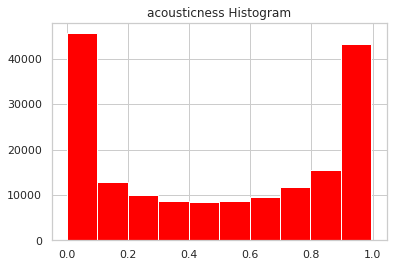

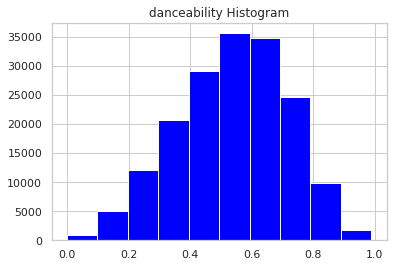

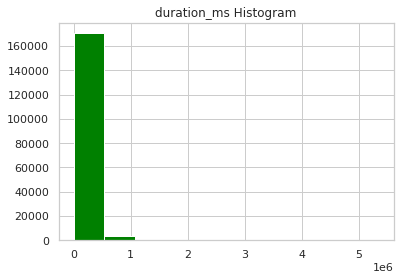

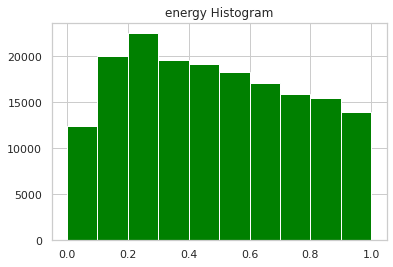

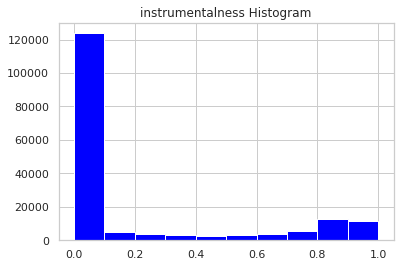

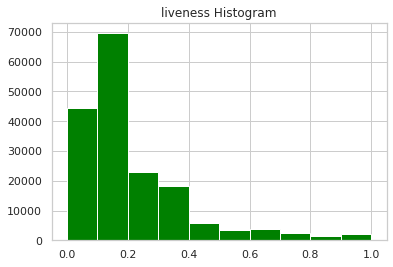

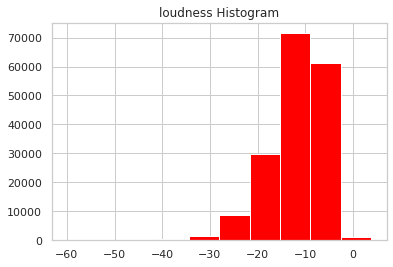

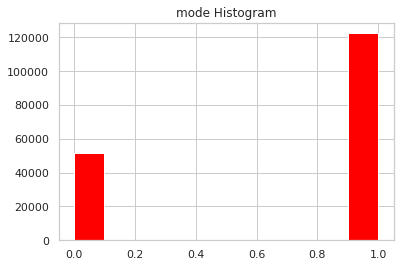

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 26376 missing from current font.

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 22291 missing from current font.

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 33457 missing from current font.

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 22909 missing from current font.

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 22825 missing from current font.

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 28079 missing from current font.

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 27468 missing from current font.

/usr/local/lib/python3.7/dist-packages/matplotli

ValueError: ignored

<Figure size 432x288 with 1 Axes>

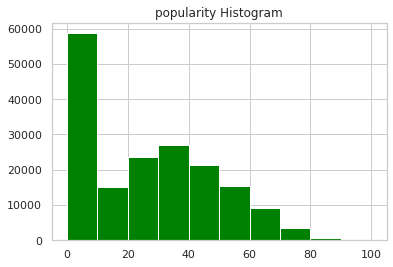

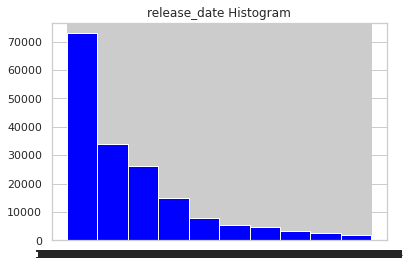

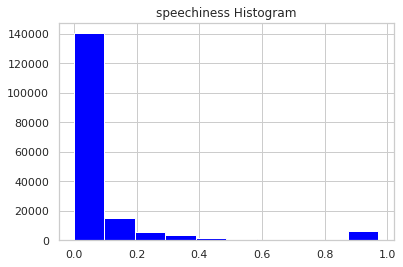

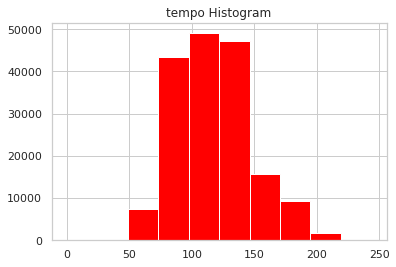

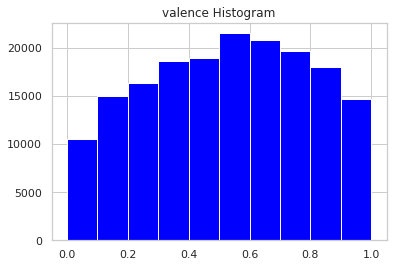

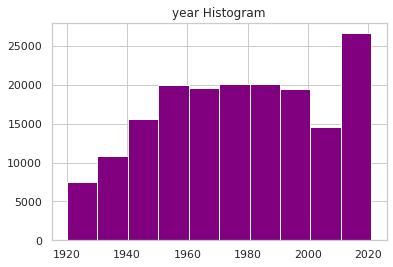

In [ ]:
#histograms per column
import random as rdn
cols = df.columns.tolist()

removal= ['artists', 'id','explicit','key'] 
for i in removal:
  cols.remove(i)
colors = ["red", "blue","green", "purple"]
for column in cols:   
  plot = df[column].hist(color = colors[rdn.randint(0,len(colors)-1)])
  plt.title(column+ " Histogram")
  fig = plot.get_figure() 
  plt.show()
  #fig.savefig("histogram" + column + ".png" )



Inferences from histograms:

Acousticness: Most songs are between 0-0.1 and 0.9-1.0

1.   Acousticness: Most songs are between 0-0.1 and 0.9-1.0
2.   Danceability: normal distribution most repeated value is 0.6
3.   Durations: Almost all track's durations are between 0-0.5 ms
4.   Energy: 0.2-0.3 was the most common interval
5.   Instrumentalness: Almost all tracks are are between 0-0.1
6.   Liveness:Most repeated interval was 0.1-0.2
7.   Loudness: Track's loudness were in the interval -25 - -5


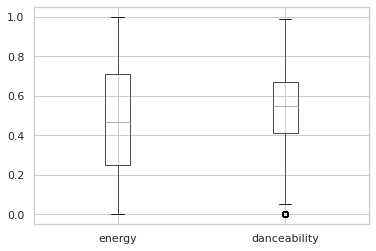

In [ ]:
boxplot = df.boxplot(column=["energy","danceability"])

**We have outliers for danceability that might need to be treated for the future works**

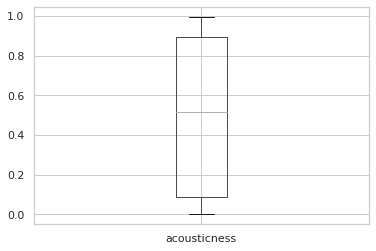

In [ ]:
boxplot = df.boxplot(column=["acousticness"])

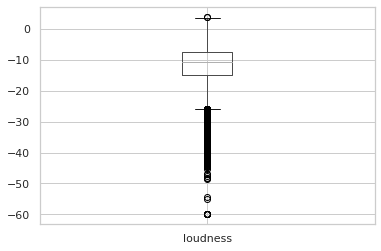

In [ ]:
boxplot = df.boxplot(column=["loudness"])

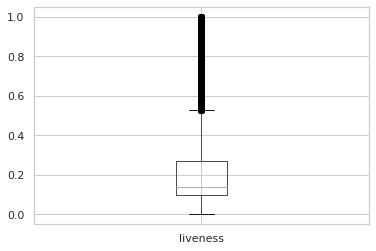

In [ ]:
boxplot = df.boxplot(column=["liveness"])

**Correlation matrix for the features**

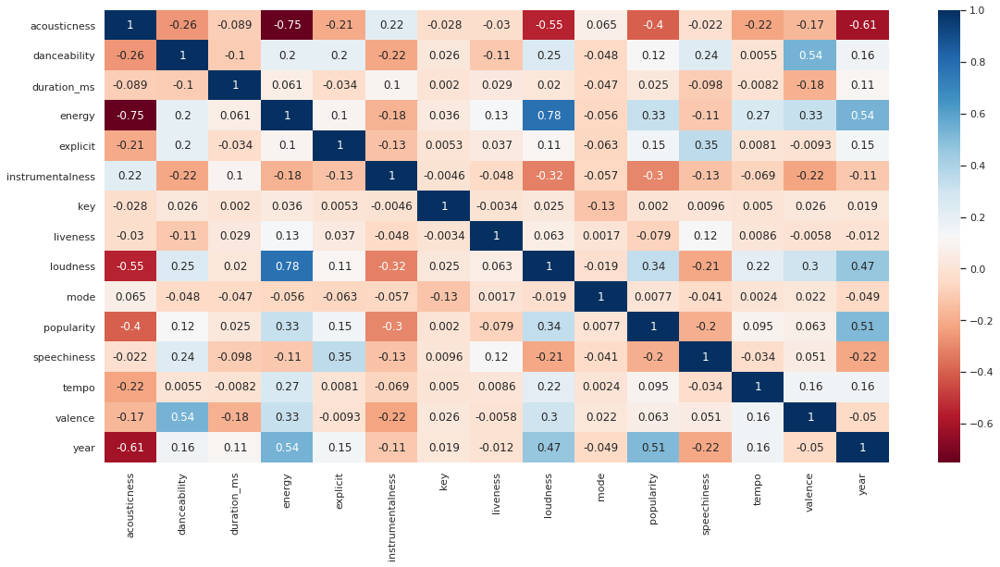

In [ ]:
from matplotlib import cm 
plt.figure(figsize=(19, 9))
corr = df.corr()
heat=sns.heatmap(corr, 
            xticklabels=corr.columns.values,
            yticklabels=corr.columns.values,cmap=cm.RdBu,annot=True)
heat.get_figure().savefig("Correlation Matrix For data_csv" + ".png" )



Infereces from the Correlation Matrix:

1.   Acousticness and Energy are negatively correlated -0.75
2.   Acousticnes and Year are negatively correlated, -0.61 suggest that new songs have relatively low acousticnes
3.   Danceability and Valence are positively correlated 0.64
4.   Energy and Loudness are positively correlated (high) 0.78
5.   Energy and Year are positively correlated 0.54 suggest that new songs have relatively more energy
6.   Loudness and Year are potively correlated (weak) new songs have more loudness compared to olders
7.   Year and Popularity are positively correlated (moderate) 0.51, newer songs are listened more
8. Popularity is positively correlated with energy and loudness, year (0.33 and 0.34, 0.54) and popularity is negatively correlated with acousticness and instrumentalness (-0.4, -0.3)

For future works, it can be concluded that acousticness of the songs decrease and energy of the songs increase as the years pass by. Furthermore, newer songs are more popular. Thus songs with low acousticness and high energy are more popular.


**Let's explore which years are the most succesfull based on popularity ratings**

###Section2:Visualizations of Aggregated Forms Based on Features#

In [ ]:
group_year = df.groupby('year')['popularity'].sum().sort_values()
print(group_year)

year
1922        11
1921        61
1924       156
1920       213
1931       214
         ...  
1997     90497
1998     91235
2002     93863
1999     93873
2020    103334
Name: popularity, Length: 102, dtype: int64


As expected, 2020 was the most popular year and oldest years were least popular based on rating since we discovered by our correlation matrix that year and popularity were positively correlated.

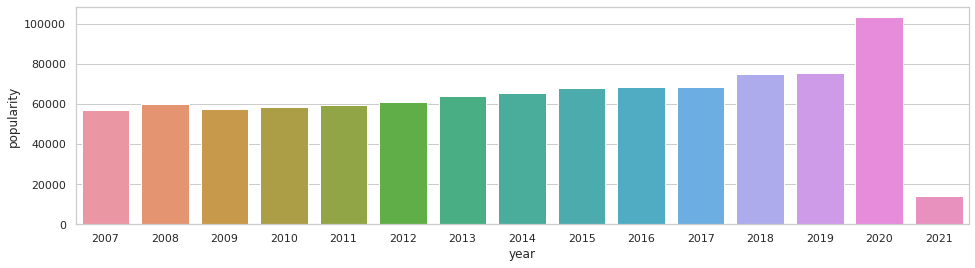

In [ ]:
group_year = df.groupby('year').agg({'popularity' : 'sum'})
plt.figure(figsize=(16,4))
sns.barplot(x = group_year.index[-15:] , y=group_year.popularity[-15:] , data = group_year)

**Number of tracks for each decade**

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



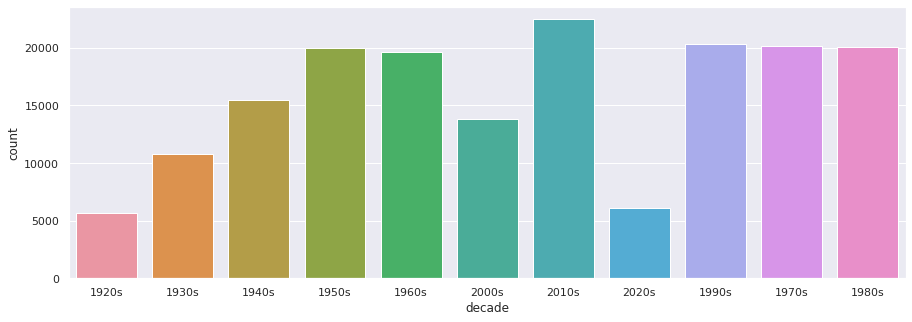

In [ ]:
def map_decade(year):
    start = int(year/10) * 10
    decade = '{}s'.format(start)
    return decade

df['decade'] = df['year'].apply(map_decade)

sns.set(rc={'figure.figsize':(15 ,5)})
sns.countplot(df['decade'])

In [ ]:
df2.sort_values(by="count",ascending=False) #Sorted by counts (most productive artists)

,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count
9761,Francisco Canaro,0.984488,0.658213,176800.691098,0.286427,0.542779,0.198878,-12.114052,0.110551,123.000891,0.742906,0.049701,2,1,3179
27354,Tadeusz Dolega Mostowicz,0.451377,0.680885,132738.188915,0.222287,0.000010,0.204249,-23.232556,0.955717,105.357162,0.565923,0.000000,1,1,2562
32374,Эрнест Хемингуэй,0.351897,0.696763,116385.067234,0.188663,0.000028,0.372711,-18.236630,0.926439,111.517753,0.587283,0.035745,11,1,2350
32373,Эрих Мария Ремарк,0.298241,0.693759,121067.432203,0.200422,0.000231,0.196048,-19.254032,0.921459,110.731847,0.536123,0.000942,0,1,2124
9832,Frank Sinatra,0.743164,0.383003,189404.126132,0.233773,0.019481,0.233630,-14.441736,0.049390,109.540857,0.363877,28.363763,5,1,1435
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14060,John Cullum,0.918000,0.575000,269507.000000,0.285000,0.000000,0.240000,-15.361000,0.262000,143.423000,0.624000,20.000000,0,1,1
14062,John Dabel,0.000050,0.688000,303750.000000,0.917000,0.717000,0.054300,-5.068000,0.046800,127.991000,0.107000,0.000000,7,1,1
1603,Ann Murray,0.973000,0.327000,184693.000000,0.458000,0.663000,0.188000,-16.084000,0.063800,179.429000,0.741000,15.000000,2,1,1
1604,Ann Nesby,0.105000,0.635000,305627.000000,0.639000,0.000000,0.125000,-5.028000,0.078200,129.024000,0.518000,34.000000,1,0,1


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]), <a list of 20 Text major ticklabel objects>)

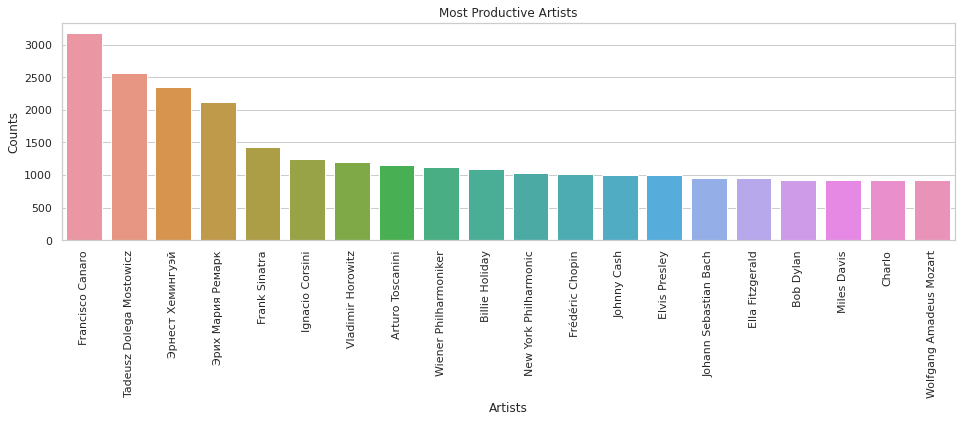

In [ ]:
plt.figure(figsize=(16, 4))
sns.set(style="whitegrid")
x = df2.groupby("artists")["count"].sum().sort_values(ascending=False).head(20)
ax = sns.barplot(x.index, x)
ax.set_title('Most Productive Artists')
ax.set_ylabel('Counts')
ax.set_xlabel('Artists')
plt.xticks(rotation = 90)


**Let's check explicit ratio for the whole dataset**

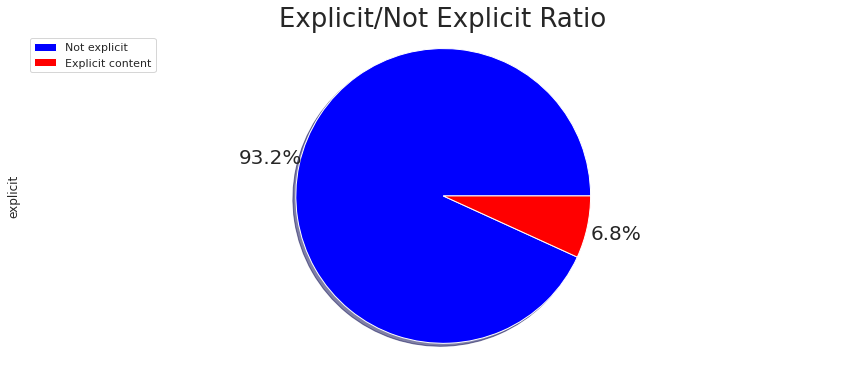

In [ ]:
list_color = ['blue','red']
mpl.rcParams['font.size'] = 20.0
ex = pd.DataFrame(df['explicit'].value_counts())
ex['explicit'].plot(kind='pie',
            figsize=(15, 6),
            autopct='%1.1f%%', 
            startangle=0,  
            shadow=True,       
            labels=None,    
            pctdistance=1.2, 
            colors=list_color,
            )

plt.title('Explicit/Not Explicit Ratio',y=1.0,fontsize=26) 
plt.axis('equal') 
plt.legend(labels=['Not explicit','Explicit content'], loc='upper left') 
plt.show()

**Let's check explicit ratio from 2000's to Today.
It seems like explicit contents increased**

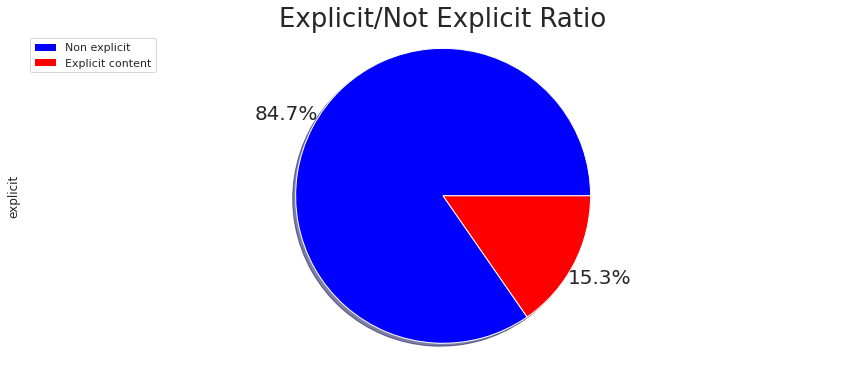

In [ ]:
latest_2000s= df[df.year > 2000] 
list_color = ['blue','red']
mpl.rcParams['font.size'] = 20.0
ex = pd.DataFrame(latest_2000s['explicit'].value_counts())
ex['explicit'].plot(kind='pie',
            figsize=(15, 6),
            autopct='%1.1f%%', 
            startangle=0,  
            shadow=True,       
            labels=None,    
            pctdistance=1.2, 
            colors=list_color,
            )

plt.title('Explicit/Not Explicit Ratio',y=1.0,fontsize=26) 
plt.axis('equal') 
plt.legend(labels=['Non explicit','Explicit content'], loc='upper left') 
plt.show()

**Audio Features of Popular Genres**

In [ ]:
df3=df3.sort_values(by="popularity",ascending=False) #Sorted by popularity, most popular genres are at top
top8=df3[:8]

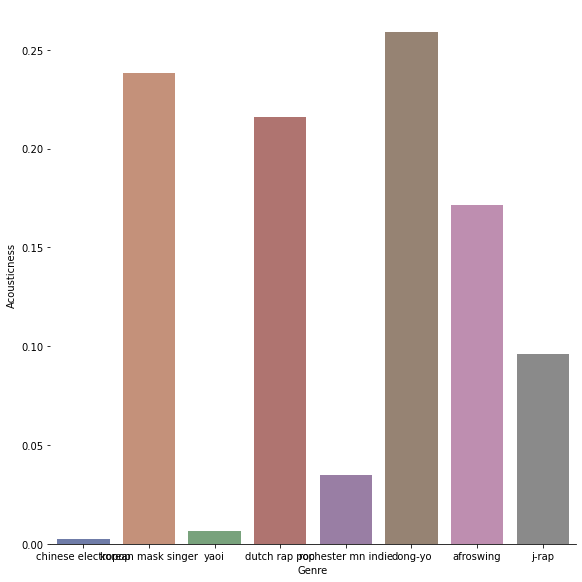

In [ ]:
g = sns.catplot(
    data=top8, kind="bar",
    x="genres", y="acousticness",
    ci="sd", palette="dark", alpha=.6, height=8
)
g.despine(left=True)
g.set_axis_labels("Genre", "Acousticness")

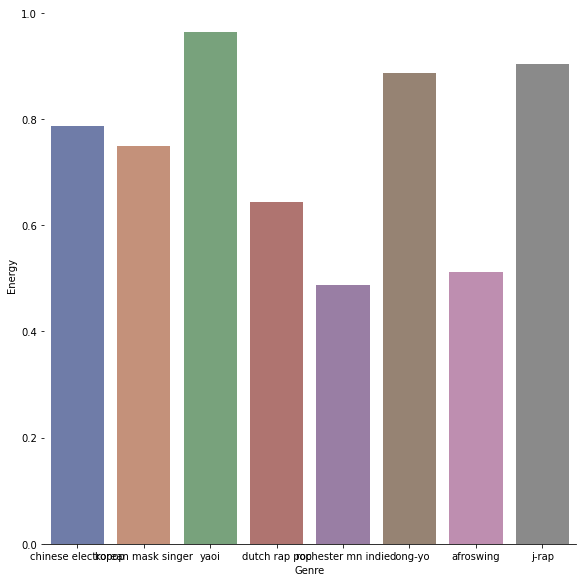

In [ ]:
g = sns.catplot(
    data=top8, kind="bar",
    x="genres", y="energy",
    ci="sd", palette="dark", alpha=.6, height=8
)
g.despine(left=True)
g.set_axis_labels("Genre", "Energy")

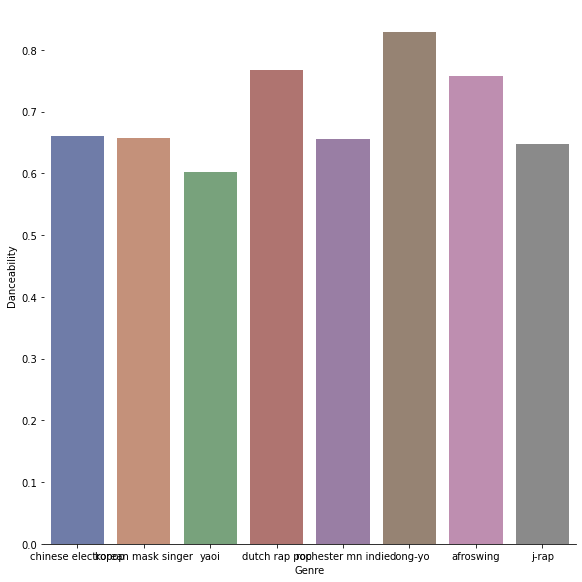

In [ ]:
g = sns.catplot(
    data=top8, kind="bar",
    x="genres", y="danceability",
    ci="sd", palette="dark", alpha=.6, height=8
)
g.despine(left=True)
g.set_axis_labels("Genre", "Danceability")

**Examination of the Relations Between the Features** 

In [ ]:
df3[["danceability", "valence"]].corr()

,danceability,valence
danceability,1.000000,0.586904
valence,0.586904,1.000000


***Danceability and valence have a positive correlation.***





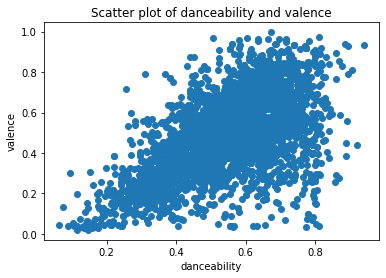

In [ ]:

# Plot
plt.scatter(df3['danceability'], df3['valence'])
plt.title('Scatter plot of danceability and valence')
plt.xlabel('danceability')
plt.ylabel('valence')
plt.show()

In [ ]:
df3[["energy", "loudness"]].corr()

,energy,loudness
energy,1.000000,0.842509
loudness,0.842509,1.000000


***Energy and loudness have a positive correlation***

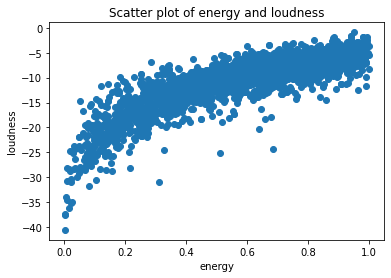

In [ ]:
# Plot
plt.scatter(df3['energy'], df3['loudness'])
plt.title('Scatter plot of energy and loudness')
plt.xlabel('energy')
plt.ylabel('loudness')
plt.show()

In [ ]:
df3[["energy", "acousticness"]].corr()

,energy,acousticness
energy,1.000000,-0.869606
acousticness,-0.869606,1.000000


***Energy and acousticness have a negative
correlation***

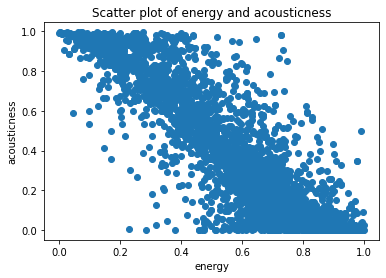

In [ ]:
# Plot
plt.scatter(df3['energy'], df3['acousticness'])
plt.title('Scatter plot of energy and acousticness')
plt.xlabel('energy')
plt.ylabel('acousticness')
plt.show()

In [ ]:
df3[["loudness", "acousticness"]].corr()

,loudness,acousticness
loudness,1.000000,-0.727258
acousticness,-0.727258,1.000000


***Loudness and acousticness have a negative correlation***

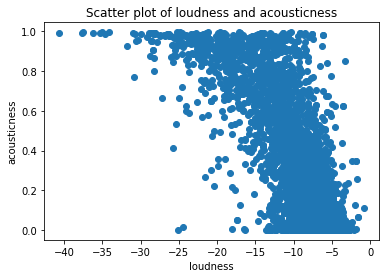

In [ ]:
# Plot
plt.scatter(df3['loudness'], df3['acousticness'])
plt.title('Scatter plot of loudness and acousticness')
plt.xlabel('loudness')
plt.ylabel('acousticness')
plt.show()

###Section3: Analysis of the Most Popular Artists and Songs

In [ ]:
df=df.sort_values(by="popularity",ascending=False) #Sorted by popularity, most popular songs are at top

**Most popular 20 songs**

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]), <a list of 20 Text major ticklabel objects>)

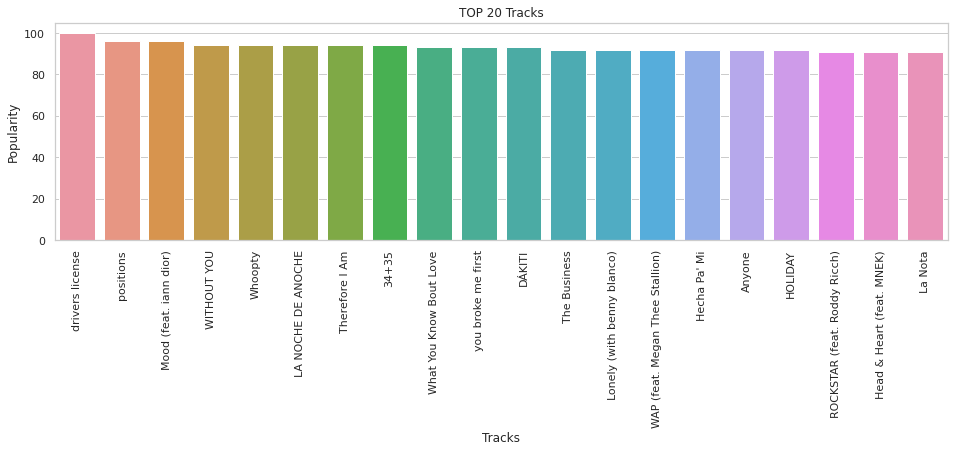

In [ ]:
plt.figure(figsize=(16, 4))
sns.set(style="whitegrid")
x = df.groupby("name")["popularity"].mean().sort_values(ascending=False).head(20)
axis = sns.barplot(x.index, x)
axis.set_title('TOP 20 Tracks')
axis.set_ylabel('Popularity')
axis.set_xlabel('Tracks')
plt.xticks(rotation = 90)


**As observed: Drivers license is the most popular track**

**Mean of features for top 20 songs:**

In [ ]:
df_tops=df[:20]
cols = df.columns.tolist()
cols2 = df_tops.columns.tolist()
removal= ['artists','id','key'] 
for i in removal:
  cols.remove(i)
  cols2.remove(i)

df_tops.describe()

,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo,valence,year
count,20.000000,20.000000,20.00000,20.000000,20.000000,20.000000,20.000000,20.000000,20.00000,20.000000,20.000000,20.000000,20.000000,20.000000,20.0
mean,0.776839,0.570650,234284.35000,0.428765,0.050000,0.388829,4.900000,0.217245,-11.20160,0.750000,2.800000,0.096975,108.099350,0.528710,1920.0
std,0.374970,0.134058,90483.23192,0.237471,0.223607,0.395664,3.477749,0.121136,3.27470,0.444262,4.873127,0.178838,24.139948,0.246927,0.0
min,0.000173,0.353000,146840.00000,0.057300,0.000000,0.000000,0.000000,0.080900,-18.71700,0.000000,0.000000,0.028900,65.485000,0.042200,1920.0
25%,0.723250,0.468750,166715.75000,0.238750,0.000000,0.017680,2.000000,0.122250,-12.53800,0.750000,0.000000,0.042400,86.579750,0.402000,1920.0
50%,0.991500,0.549500,196913.50000,0.403000,0.000000,0.182500,5.000000,0.177500,-11.68100,1.000000,0.000000,0.047000,112.042500,0.540500,1920.0
75%,0.993750,0.657250,277993.25000,0.521000,0.000000,0.818250,8.000000,0.297000,-9.11175,1.000000,4.250000,0.062925,127.244000,0.692500,1920.0
max,0.996000,0.852000,476304.00000,0.998000,1.000000,0.960000,11.000000,0.519000,-6.03600,1.000000,17.000000,0.845000,149.976000,0.950000,1920.0


In [ ]:
df2=df2.sort_values(by="popularity",ascending=False) #Sorted by popularity, most popular artists are at top

**#Most popular 20 artists:**

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]), <a list of 20 Text major ticklabel objects>)

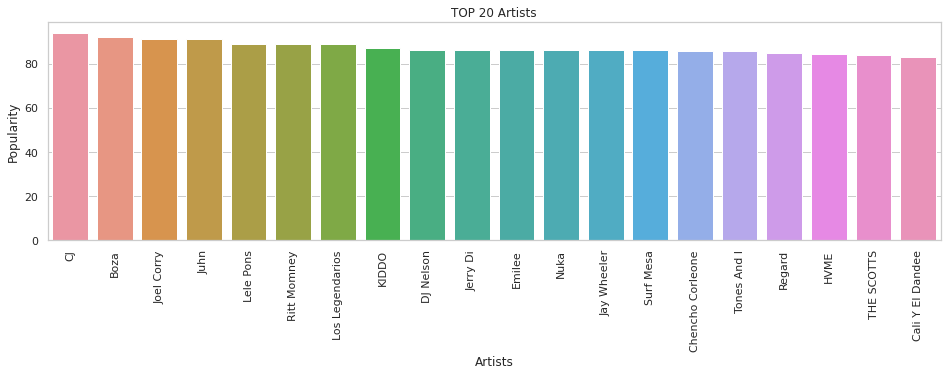

In [ ]:
plt.figure(figsize=(16, 4))
sns.set(style="whitegrid")
x = df2.groupby("artists")["popularity"].sum().sort_values(ascending=False).head(20)
ax = sns.barplot(x.index, x)
ax.set_title('TOP 20 Artists')
ax.set_ylabel('Popularity')
ax.set_xlabel('Artists')
plt.xticks(rotation = 90)


As observed: CJ is the most popular artist

**#Mean of features for top 20 artists:**

In [ ]:
#Mean of features for top 20 artists:
df2_tops=df2[:20]
cols = df2.columns.tolist()
cols2 = df2_tops.columns.tolist()
removal= ['artists','count','key'] 
for i in removal:
  cols.remove(i)
  cols2.remove(i)

df2_tops.describe()

,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count
count,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000
mean,0.515188,0.606923,231982.951230,0.478344,0.031771,0.270891,-10.966864,0.182920,112.618545,0.522763,35.389678,4.800000,0.900000,16.200000
std,0.291317,0.170262,77816.045581,0.187493,0.048000,0.222566,4.522293,0.140239,23.265425,0.239098,23.978948,3.442765,0.307794,26.450749
min,0.037500,0.348286,130375.000000,0.169000,0.000000,0.073600,-20.615000,0.030800,77.375857,0.176000,0.000000,0.000000,0.000000,2.000000
25%,0.225955,0.465857,157607.072464,0.357304,0.000020,0.147397,-14.633404,0.094476,93.999958,0.357454,24.653846,1.750000,1.000000,2.000000
50%,0.564583,0.593396,220168.250000,0.499143,0.009831,0.205453,-10.381690,0.152493,108.604525,0.495810,34.489418,5.000000,1.000000,5.000000
75%,0.755500,0.732500,274647.107143,0.615437,0.036937,0.291091,-8.622042,0.247750,128.204750,0.746146,51.750000,7.250000,1.000000,18.000000
max,0.927000,0.923000,387293.666667,0.822000,0.186000,0.970000,-4.098000,0.607667,171.167667,0.902000,74.166667,10.000000,1.000000,106.000000


**Visualization of Audio Features for Top Artists**

In [ ]:
top5_art=df2[:5]

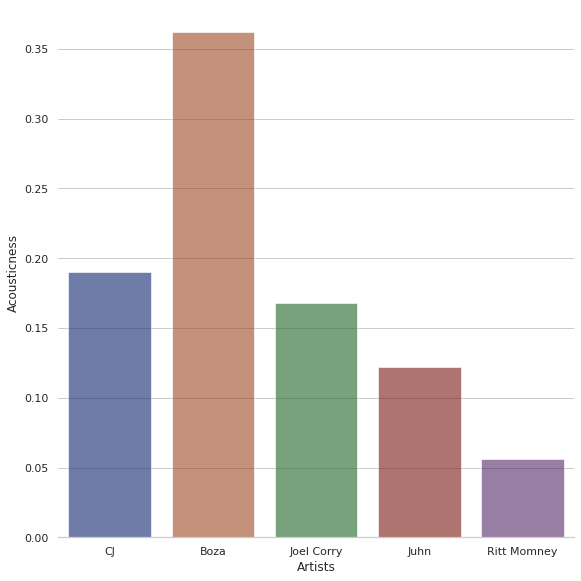

In [ ]:
g = sns.catplot(
    data=top5_art, kind="bar",
    x="artists", y="acousticness",
    ci="sd", palette="dark", alpha=.6, height=8
)
g.despine(left=True)
g.set_axis_labels("Artists", "Acousticness")

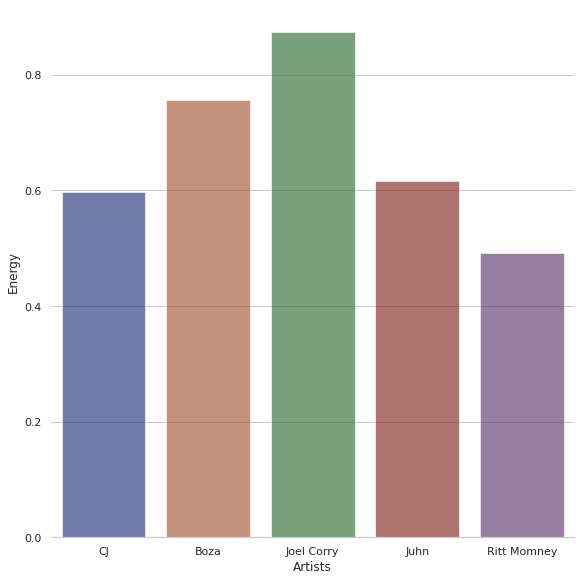

In [ ]:
g = sns.catplot(
    data=top5_art, kind="bar",
    x="artists", y="energy",
    ci="sd", palette="dark", alpha=.6, height=8
)
g.despine(left=True)
g.set_axis_labels("Artists", "Energy")

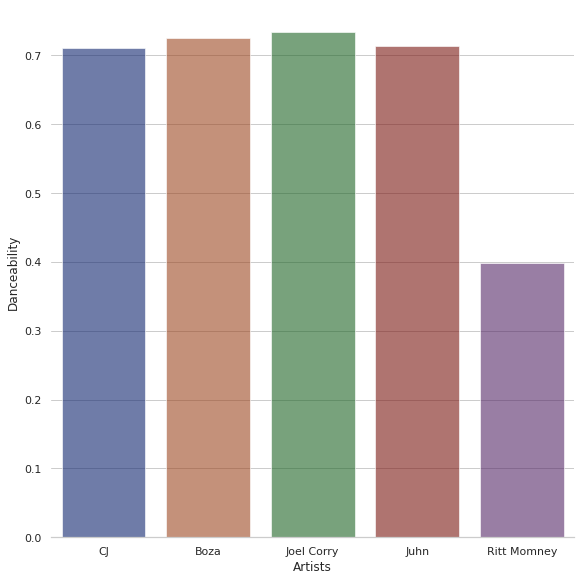

In [ ]:
g = sns.catplot(
    data=top5_art, kind="bar",
    x="artists", y="danceability",
    ci="sd", palette="dark", alpha=.6, height=8
)
g.despine(left=True)
g.set_axis_labels("Artists", "Danceability")

**Most Popular Artists for Popular Aggregated Genres such as Rock,Pop,Rap**

**The dataframe merged was obtained in Statistical Tests Part, after obtaining merge we can easily achieve general genres **

In [ ]:
import re
data2=merged

sample_rock1 = merged[merged.genres == 'rock']
sample_pop = merged[merged.genres == 'pop']
sample_rap = merged[merged.genres == 'rap']



/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]), <a list of 20 Text major ticklabel objects>)

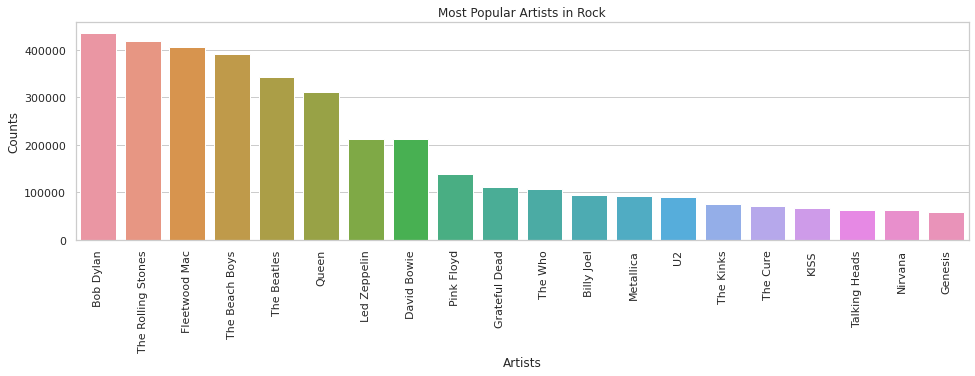

In [ ]:
plt.figure(figsize=(16, 4))
sns.set(style="whitegrid")
x = sample_rock1.groupby("artists")["count"].sum().sort_values(ascending=False).head(20)
ax = sns.barplot(x.index, x)
ax.set_title('Most Popular Artists in Rock')
ax.set_ylabel('Counts')
ax.set_xlabel('Artists')
plt.xticks(rotation = 90)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]), <a list of 20 Text major ticklabel objects>)

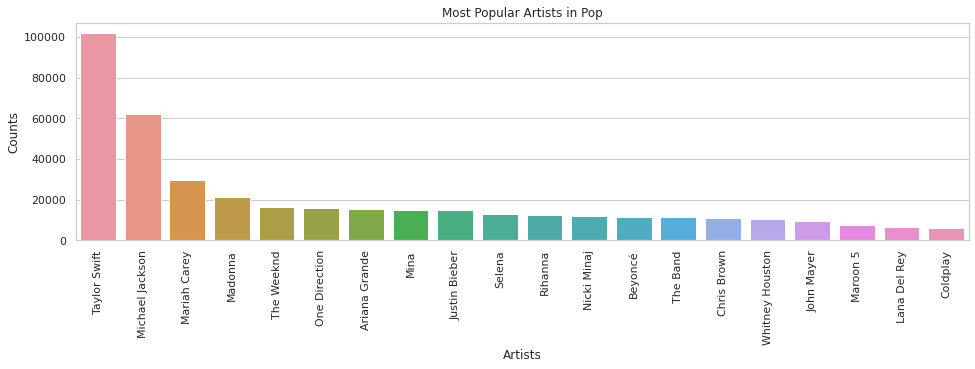

In [ ]:
plt.figure(figsize=(16, 4))
sns.set(style="whitegrid")
x = sample_pop.groupby("artists")["count"].sum().sort_values(ascending=False).head(20)
ax = sns.barplot(x.index, x)
ax.set_title('Most Popular Artists in Pop')
ax.set_ylabel('Counts')
ax.set_xlabel('Artists')
plt.xticks(rotation = 90)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]), <a list of 20 Text major ticklabel objects>)

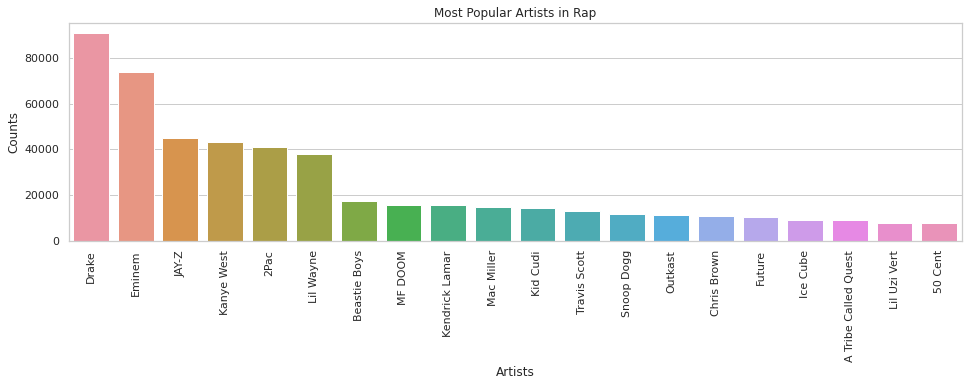

In [ ]:
plt.figure(figsize=(16, 4))
sns.set(style="whitegrid")
x = sample_rap.groupby("artists")["count"].sum().sort_values(ascending=False).head(20)
ax = sns.barplot(x.index, x)
ax.set_title('Most Popular Artists in Rap')
ax.set_ylabel('Counts')
ax.set_xlabel('Artists')
plt.xticks(rotation = 90)

###Section4: How Songs of Different Genres Change Over Time

Let's observe how features changed for all kind of genres between the year interval 1920-2020

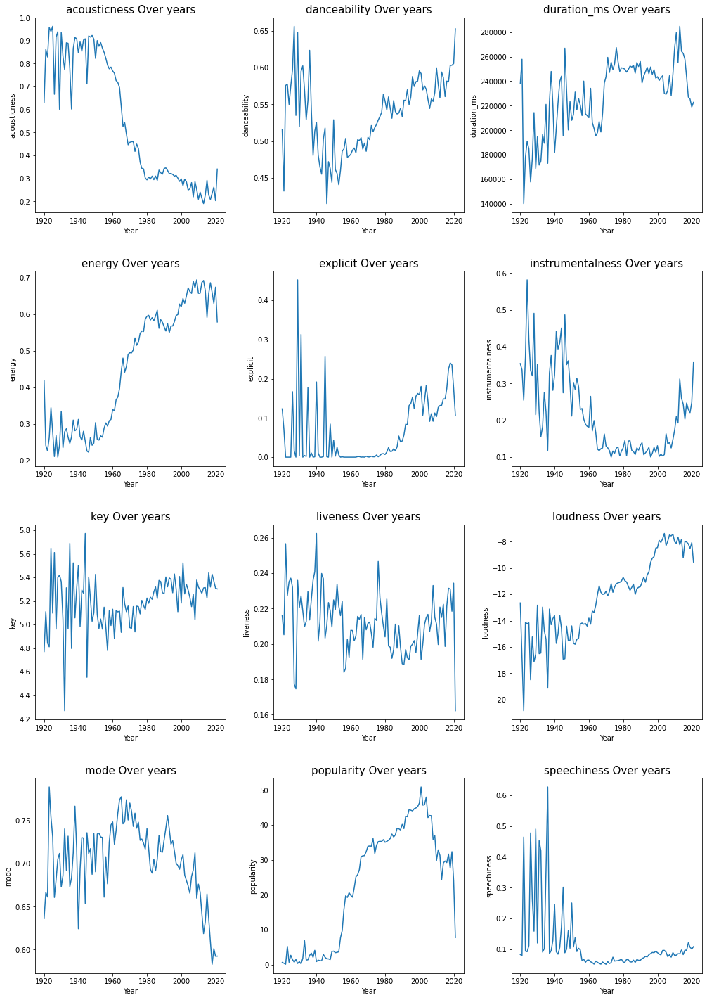

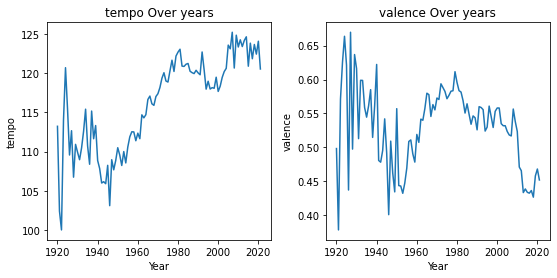

In [ ]:
groups = df[df['year']>=1920].groupby(['year']).mean()
fig, axes1 = plt.subplots(4, 3, figsize=(17, 25))
plt.subplots_adjust(hspace=0.3, wspace=0.25)
fig, axes2 = plt.subplots(1, 2, figsize=(9, 4))
plt.subplots_adjust(wspace=0.25)

for row in axes1:
    for ax in row:
        col = groups.columns[list(axes1.flatten()).index(ax)]
        ax.plot(groups.index, groups[col])
        ax.set_title(col + ' Over years', size=15)
        ax.set_xlabel('Year')
        ax.set_ylabel(col)
        
for ax in axes2:
    col = groups.columns[list(axes2.flatten()).index(ax)+12]
    ax.plot(groups.index, groups[col])
    ax.set_title(col + ' Over years', size=12)
    ax.set_xlabel('Year')
    ax.set_ylabel(col)
plt.show()


**Loudness and energy increased significantly over years and acousticness decreased significantly**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px 
from google.colab import drive
from os.path import join
drive.mount('/content/drive')
import ast


Mounted at /content/drive


In order to use year data we must join 2 data frames with using artists name as a key and left join them

In [ ]:
filename2 = "data_w_genres_o.csv"  
path = "./drive/My Drive/CS210ProjectDatas"
df = pd.read_csv(join(path, filename2))

df['genres'] = df['genres'].apply(ast.literal_eval)
df = df.explode('genres') # explode in order to anlyze every genre
df = df.sort_values('artists')



df.head()

,genres,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count
0,show tunes,"""Cats"" 1981 Original London Cast",0.590111,0.467222,250318.555556,0.394003,0.011400,0.290833,-14.448000,0.210389,117.518111,0.389500,38.333333,5,1,9
1,NaN,"""Cats"" 1983 Broadway Cast",0.862538,0.441731,287280.000000,0.406808,0.081158,0.315215,-10.690000,0.176212,103.044154,0.268865,30.576923,5,1,26
2,NaN,"""Fiddler On The Roof” Motion Picture Chorus",0.856571,0.348286,328920.000000,0.286571,0.024593,0.325786,-15.230714,0.118514,77.375857,0.354857,34.857143,0,1,7
3,NaN,"""Fiddler On The Roof” Motion Picture Orchestra",0.884926,0.425074,262890.962963,0.245770,0.073587,0.275481,-15.639370,0.123200,88.667630,0.372030,34.851852,0,1,27
4,NaN,"""Joseph And The Amazing Technicolor Dreamcoat""...",0.510714,0.467143,270436.142857,0.488286,0.009400,0.195000,-10.236714,0.098543,122.835857,0.482286,43.000000,5,1,7


In [ ]:
f= "data_o.csv"  
path = "./drive/My Drive/CS210ProjectDatas"
df2 = pd.read_csv(join(path, f))
df2['artists'] = df2['artists'].apply(ast.literal_eval)
df2 = df2.explode('artists')
df2=df2.sort_values('artists')
df2.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
101046,0.700,1981,0.124,"""Cats"" 1981 Original London Cast",0.633,185867,0.589,0,4zYZp4O4kCa4oXkwI1Yx9H,0.000000,9,0.6130,-11.754,1,The Rum Tum Tugger,37,1981-01-01,0.2080,127.622
117080,0.718,1981,0.548,"""Cats"" 1981 Original London Cast",0.580,285640,0.550,0,3RQqmx8DhODIDLTeYMiL7K,0.000000,4,0.3040,-11.377,1,Skimbleshanks: The Railway Cat,38,1981-01-01,0.1630,146.827
133078,0.100,1981,0.773,"""Cats"" 1981 Original London Cast",0.277,256507,0.228,0,44VoCOPuYs1zKklhslfazm,0.003110,8,0.0935,-9.762,1,Memory - Radio Edit,37,1981-01-01,0.0319,62.511
147863,0.586,1981,0.661,"""Cats"" 1981 Original London Cast",0.696,230093,0.306,0,2qJH39hThPyUGNbZ5wPHrc,0.000006,2,0.2570,-12.909,1,Mungojerrie And Rumpelteazer,33,1981-01-01,0.3960,90.251
133133,0.215,1981,0.533,"""Cats"" 1981 Original London Cast",0.516,339000,0.524,0,5kC8eiltidjSvRE2p0nMKU,0.000002,0,0.1090,-14.136,0,Prologue: Jellicle Songs For Jellicle Cats,36,1981-01-01,0.3780,142.816


Drop 

In [ ]:
del df2['valence']
del df2['acousticness']
del df2['danceability']
del df2['energy']
del df2['explicit']
del df2['id']
del df2['instrumentalness']
del df2['key']
del df2['liveness']
del df2['loudness']
del df2['mode']
del df2['popularity']
del df2['duration_ms']
del df2['release_date']
del df2['speechiness']
del df2['tempo']
#del df2['name']
#unnecessary data deleted

In [ ]:
df2 = df2.groupby('artists', as_index=False).mean()

In [ ]:
df2.head()

,artists,year
0,"""Cats"" 1981 Original London Cast",1981.0
1,"""Cats"" 1983 Broadway Cast",1983.0
2,"""Fiddler On The Roof” Motion Picture Chorus",1971.0
3,"""Fiddler On The Roof” Motion Picture Orchestra",1971.0
4,"""Joseph And The Amazing Technicolor Dreamcoat""...",1991.0


In [ ]:
df3 = pd.merge(df,df2,how = "left")

In [ ]:
nds = df3
df3.head()



,genres,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count,year
0,show tunes,"""Cats"" 1981 Original London Cast",0.590111,0.467222,250318.555556,0.394003,0.011400,0.290833,-14.448000,0.210389,117.518111,0.389500,38.333333,5,1,9,1981.0
1,NaN,"""Cats"" 1983 Broadway Cast",0.862538,0.441731,287280.000000,0.406808,0.081158,0.315215,-10.690000,0.176212,103.044154,0.268865,30.576923,5,1,26,1983.0
2,NaN,"""Fiddler On The Roof” Motion Picture Chorus",0.856571,0.348286,328920.000000,0.286571,0.024593,0.325786,-15.230714,0.118514,77.375857,0.354857,34.857143,0,1,7,1971.0
3,NaN,"""Fiddler On The Roof” Motion Picture Orchestra",0.884926,0.425074,262890.962963,0.245770,0.073587,0.275481,-15.639370,0.123200,88.667630,0.372030,34.851852,0,1,27,1971.0
4,NaN,"""Joseph And The Amazing Technicolor Dreamcoat""...",0.510714,0.467143,270436.142857,0.488286,0.009400,0.195000,-10.236714,0.098543,122.835857,0.482286,43.000000,5,1,7,1991.0


In [ ]:
df3.dropna(subset = ["genres"], inplace=True)

In [ ]:
df3.head()

,genres,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count,year
0,show tunes,"""Cats"" 1981 Original London Cast",0.590111,0.467222,250318.555556,0.394003,0.011400,0.290833,-14.448000,0.210389,117.518111,0.389500,38.333333,5,1,9,1981.000000
8,parody,"""Weird Al"" Yankovic",0.173145,0.662787,218948.196721,0.695393,0.000050,0.161102,-9.768705,0.084536,133.031180,0.751344,34.229508,9,1,122,1990.754098
9,comedy rock,"""Weird Al"" Yankovic",0.173145,0.662787,218948.196721,0.695393,0.000050,0.161102,-9.768705,0.084536,133.031180,0.751344,34.229508,9,1,122,1990.754098
10,comic,"""Weird Al"" Yankovic",0.173145,0.662787,218948.196721,0.695393,0.000050,0.161102,-9.768705,0.084536,133.031180,0.751344,34.229508,9,1,122,1990.754098
11,vapor trap,$NOT,0.544467,0.789800,137910.466667,0.532933,0.023063,0.180300,-9.149267,0.293687,112.344800,0.480700,67.533333,1,1,15,2019.454545


In [ ]:
dict_of_genres = {k: v for k, v in df3.groupby('genres')}
arr = []

for i in dict_of_genres.keys():
  arr.append(pd.DataFrame.from_dict(dict_of_genres[i]))


for i in range(len(arr)):

  metric_cols = ['acousticness'	,'danceability'	,'duration_ms'	,'energy',	'instrumentalness',	'liveness','loudness',	'speechiness',	'tempo'	,'valence'	,'popularity'	,'key'	,'mode'	,'count']
  group_cols = ['year']
  aggs = arr[i].groupby(group_cols)[metric_cols].mean()

  arr[i].drop(metric_cols, axis=1, inplace=True)

  arr[i].drop_duplicates(subset=group_cols, keep='last', inplace=True)

  arr[i] = arr[i].merge(right=aggs, right_index=True, left_on=group_cols, how='right')

In [ ]:
arr[1000].head()

,genres,artists,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count
849,europop,Abdul,1945.000000,0.994000,0.599000,153228.000000,0.104000,0.009460,0.108000,-10.296000,0.100000,131.624000,0.607000,0.000000,11.0,1.0,2.0
8521,europop,Boney M.,1979.681818,0.189025,0.713500,269535.181818,0.768864,0.138224,0.204423,-7.870045,0.058859,122.565182,0.886136,47.636364,0.0,1.0,44.0
25228,europop,Goombay Dance Band,1980.500000,0.387200,0.559000,251125.000000,0.705500,0.000126,0.610000,-10.324500,0.030750,109.316000,0.807000,50.500000,11.0,1.0,4.0
66227,europop,The Pointer Sisters,1982.718750,0.145209,0.699844,271616.625000,0.696719,0.001658,0.225306,-9.353625,0.069131,128.087500,0.813625,42.218750,5.0,1.0,64.0
655,europop,ABBA,1983.055556,0.345722,0.575167,232053.730159,0.659586,0.020650,0.205305,-8.492929,0.038050,121.576206,0.667937,43.253968,2.0,1.0,252.0


Here are the most popular genres

In [ ]:
import operator
popularity_of_genre_dict ={}
for i in arr:
  popularity_of_genre_dict[i.iloc[0]['genres']] = i['popularity'].sum()
most_populer_genres = sorted(popularity_of_genre_dict, key=popularity_of_genre_dict.get, reverse=True)[:10]
print(most_populer_genres)

['rock', 'pop', 'dance pop', 'rap', 'pop rap', 'hip hop', 'pop rock', 'latin', 'soft rock', 'urban contemporary']


Let's obsreve how the features of these genres changed over years

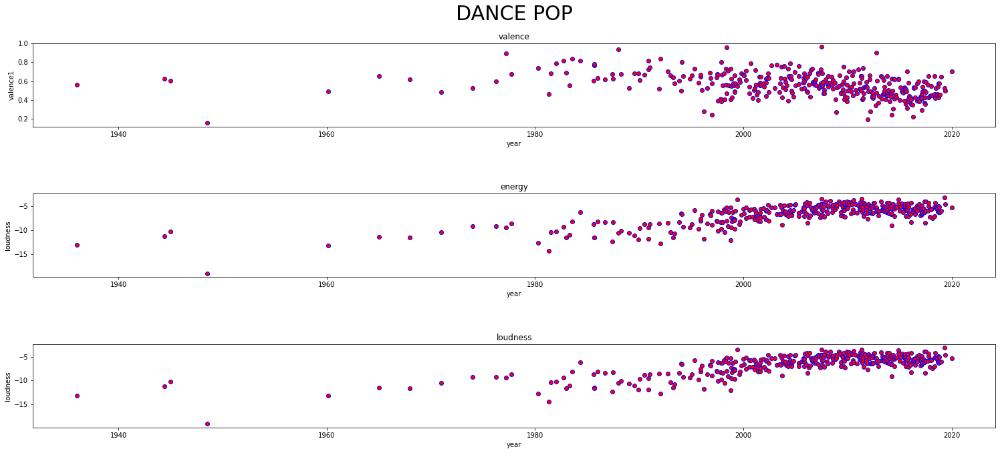

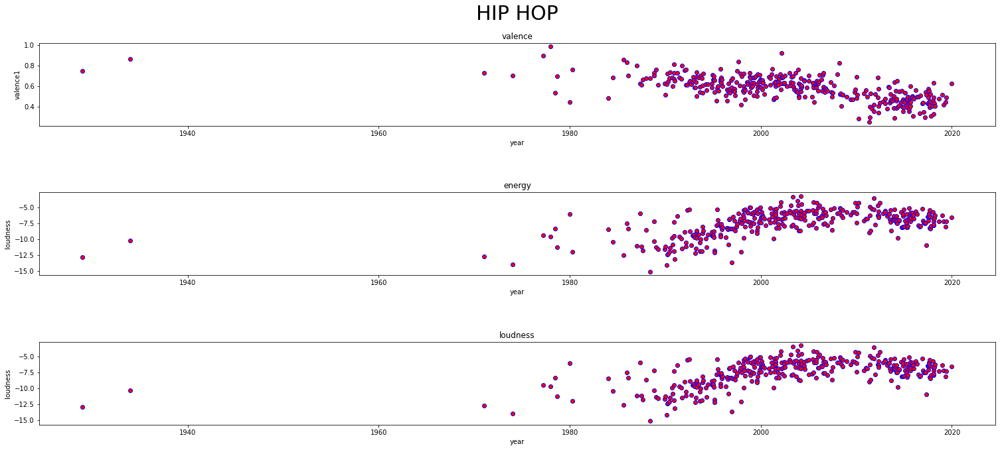

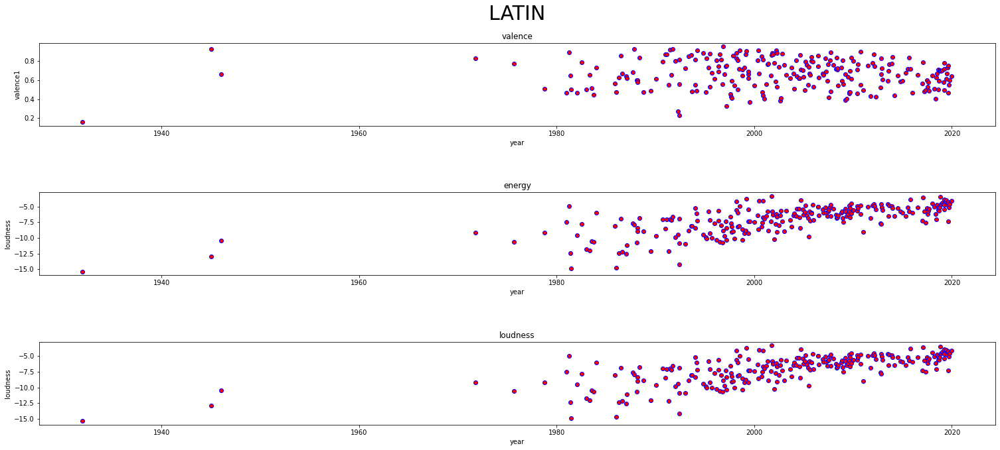

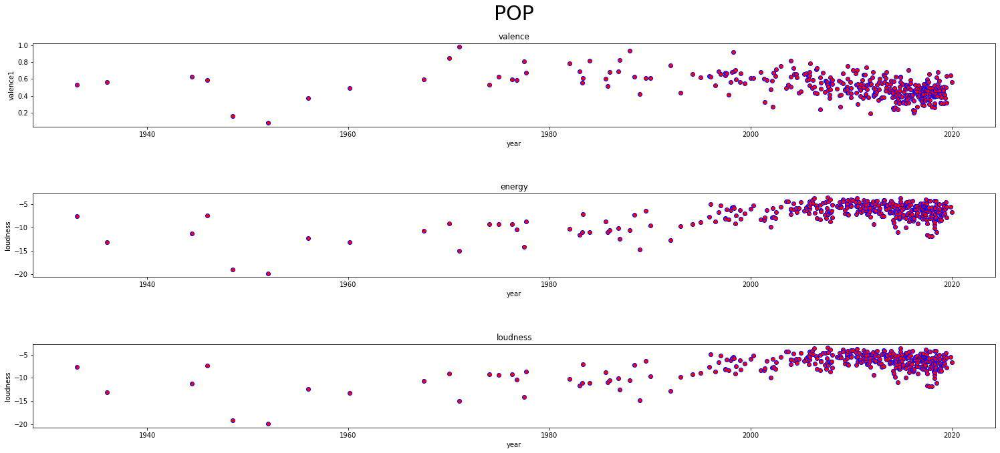

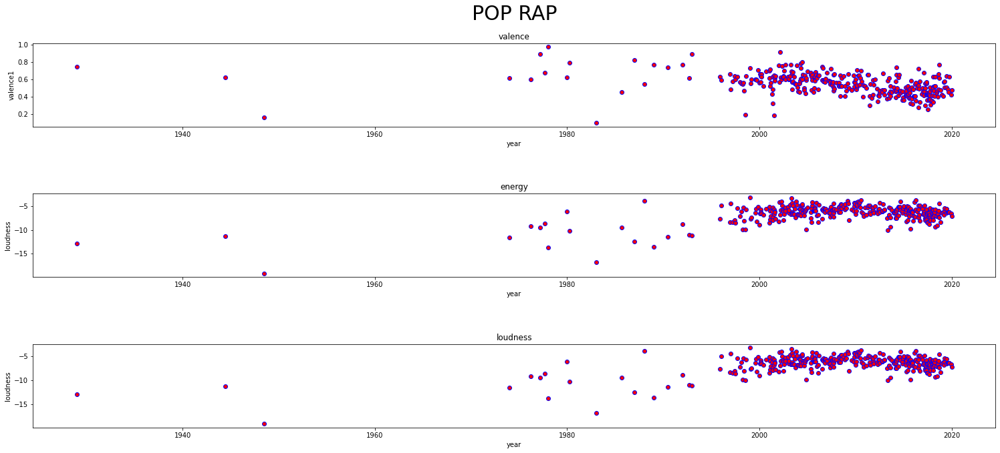

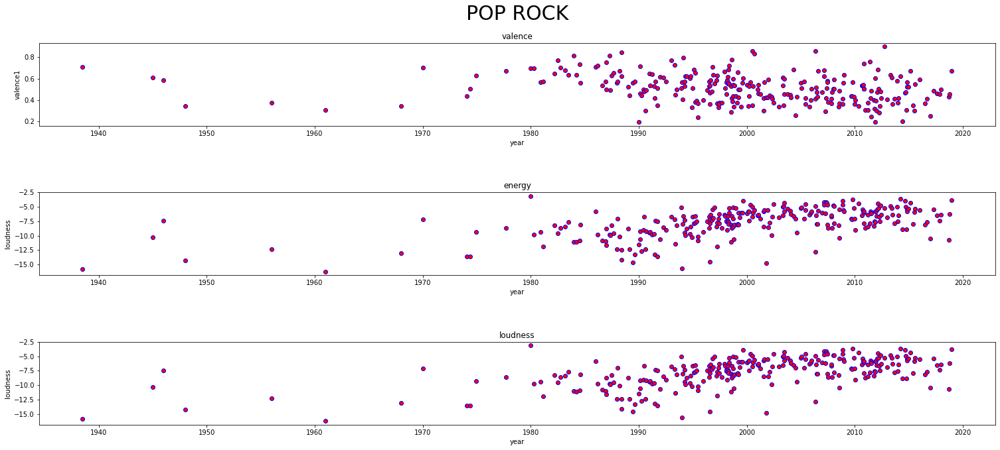

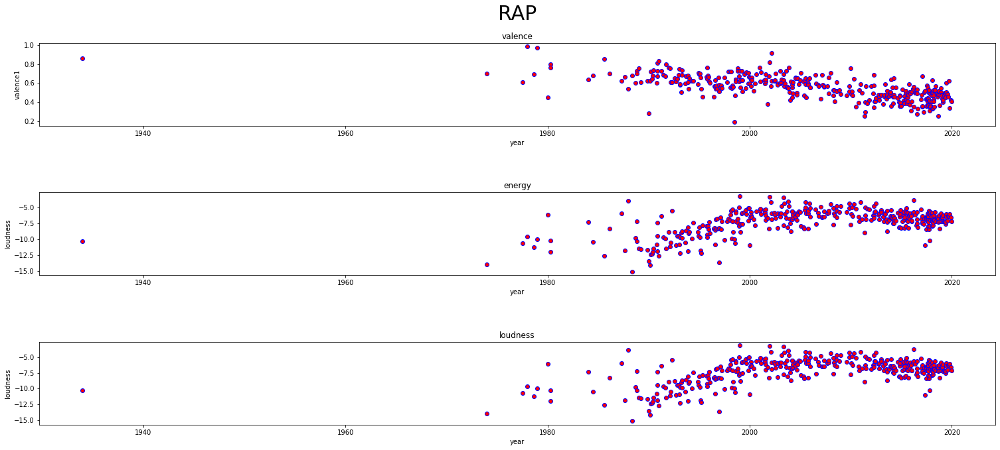

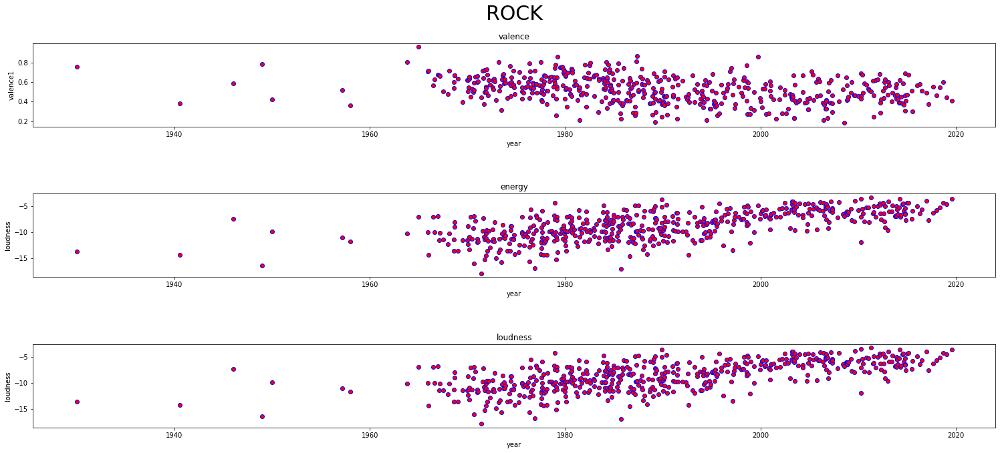

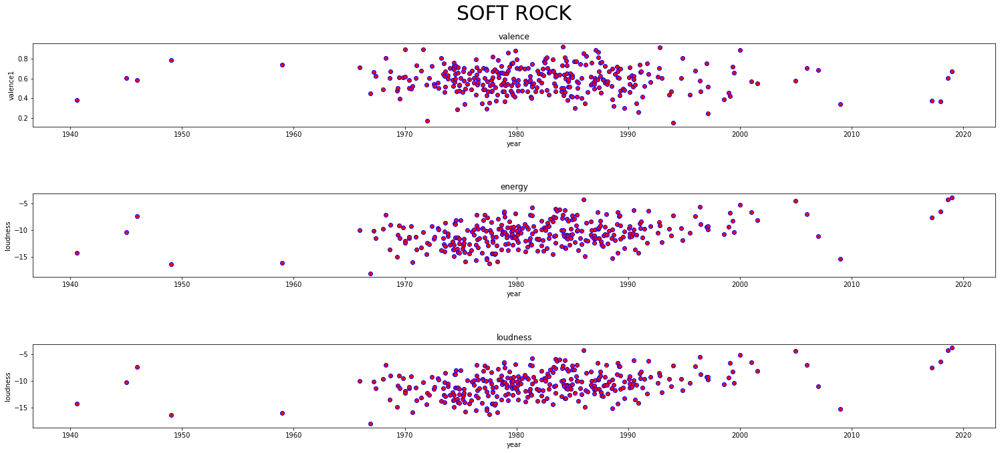

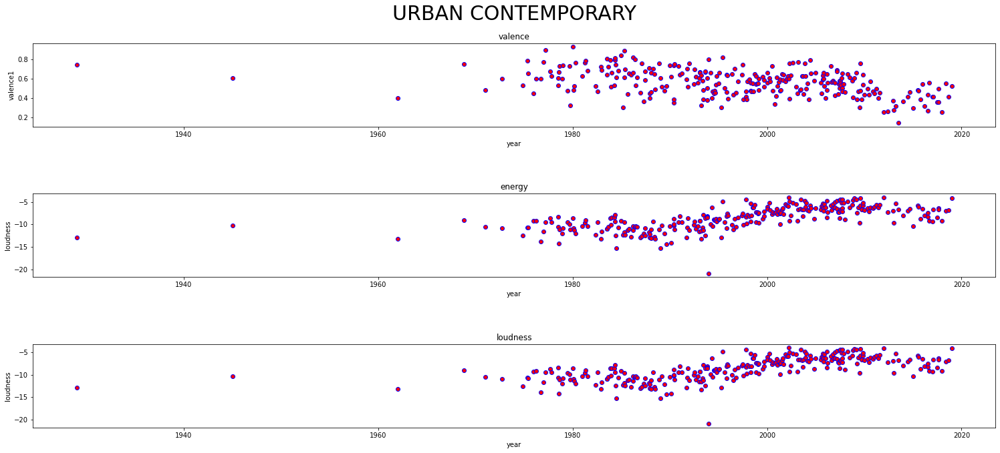

In [ ]:
#displays top ten geners change over time
for i in range(len(arr)):
  if(arr[i].iloc[0]['genres'] in most_populer_genres):
    
    fig, (ax1, ax2,ax3) = plt.subplots(3,1,figsize=(25,10) )
    plt.subplots_adjust(left=0.1,bottom=0.1, right=0.9, top=0.9, wspace=0.4, hspace=0.8)

    fig.suptitle(arr[i].iloc[0]['genres'].upper(),fontsize=30,verticalalignment = 'top')
    
    



    #ax1.plot( 'year', 'danceability', data=arr[i], marker='', markersize=1, color='blue', linewidth=1)
    ax1.scatter(x=arr[i]['year'], y=arr[i]['valence'], marker='o', c='r', edgecolor='b')
    ax1.set_title('valence')
    ax1.set(xlabel='year', ylabel='valence1')



    #ax2.plot( 'year', 'energy', data=arr[i], marker='', color='red', linewidth=1)
    ax2.scatter(x=arr[i]['year'], y=arr[i]['loudness'], marker='o', c='r', edgecolor='b')
    ax2.set_title('energy')
    ax2.set(xlabel='year', ylabel='loudness')



    #ax3.plot( 'year', 'instrumentalness', data=arr[i], marker='', color='green', linewidth=1)
    ax3.scatter(x=arr[i]['year'], y=arr[i]['loudness'], marker='o', c='r', edgecolor='b')
    ax3.set_title('loudness')
    ax3.set(xlabel='year', ylabel='loudness')
    
    print("\n\n\n")

 

  
    plt.show()


###Future Works

**In the next step, we are going to do Statistical Analysis & Hypothesis Testing. We will do statistical tests to check how and if features contribute to popularity of songs. Also we are going to do check if significant differences exist between different eras. From this step, we know the facts that popularity is positively correlated with energy and loudness, year (0.33 and 0.34, 0.54) and popularity is negatively correlated with acousticness and instrumentalness (-0.4, -0.3)**



#Statistical Analysis & Hypothesis Testing

##Statistical tests to check how features contribute to popularity of songs

**In this part, we will make some statistical tests to check features contributition to popularity of songs and we will also make statistical tests to differentiate specific eras. We will try to explain the reasons behind.**


###Popularity vs Acousticness

**From the pairwise correlation matrix, we know that popularity is negatively correlated with acousticness. We expect songs with high acousticness to have lower popularity rating.** 


Hypothesis Test: We want to test whether acousticness of a song affects popularity.

**Null Hypothesis ($H_0$)**: Acousticness does not affect popularity.

**Alternative Hypothesis ($H_A$)**: Acousticness affects popularity.

Before applying an appropriate test, let's check z scores and compare the means of acousticness based on popularity.

In [ ]:
from sklearn import datasets
from scipy import stats
from scipy.stats import ttest_1samp

Sample1 has higher popularity than the mean popularity of the whole dataset.
Sample2 has lower popularity than the mean popularity of the whole dataset.

In [ ]:
sample1 = df[df.popularity > df['popularity'].mean()]
sample2=df[df.popularity <= df['popularity'].mean()] 
print(sample1.size)
print(sample2.size)

1652506
1660885


With the z-score at hand, we can display how distant sample1's acousticness mean is from the whole dataset's acousticness mean

In [ ]:
mean=df['acousticness'].mean()
sample_mean=sample1['acousticness'].mean()
std=df['acousticness'].std()
z_score = (sample_mean- mean) / std
print("Mean of Acousticness of whole data set ",df['acousticness'].mean()) 
print("Mean of Acousticness of sample1 (Higher popularity group)",sample1['acousticness'].mean()) 
print("Sample1's acousticness (Higher popularity group) deviate",z_score,"from the whole data set") 

Mean of Acousticness of whole data set  0.49922848176599677
Mean of Acousticness of sample1 (Higher popularity group) 0.35535808842527133
Sample1's acousticness (Higher popularity group) deviate -0.3786702318770541 from the whole data set


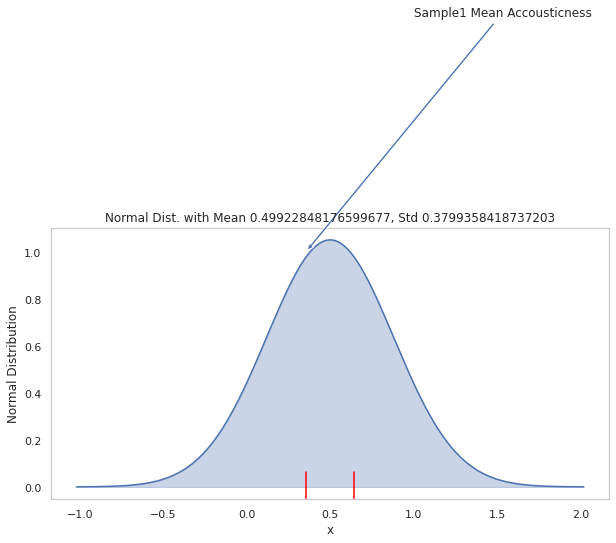

In [ ]:
offset = 4*std
n=df.size

x = np.linspace(mean - offset, mean + offset, n)

y = stats.norm.pdf(x,mean,std)

plt.figure(figsize=(10, 5))
plt.plot(x,y)

plt.grid()
plt.xlabel('x')
plt.ylabel('Normal Distribution')
plt.fill_between(x, y, alpha=0.3, color='b')

plt.axvline(mean - z_score*std, ymax=0.1, color="red")
plt.axvline(mean + z_score*std, ymax=0.1, color="red")

plt.annotate(
    "Sample1 Mean Accousticness", # annotation text
    xy=(mean + z_score*std, 1), # annotated coordinate
    xytext=(1, 2), # annotation text coordinate
    arrowprops={"arrowstyle": "simple"}) # arrow style
plt.title('Normal Dist. with Mean {}, Std {}'.format(mean, std))
plt.show()

Let's compare sample1 and samples2's acousticness histograms

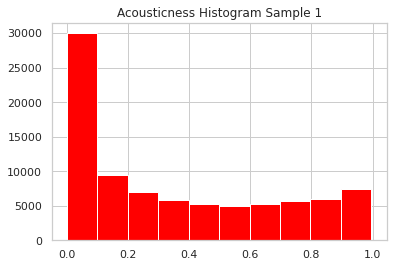

In [ ]:
plot = sample1["acousticness"].hist(color = "red")
plt.title("Acousticness Histogram Sample 1")
fig = plot.get_figure() 
plt.show()

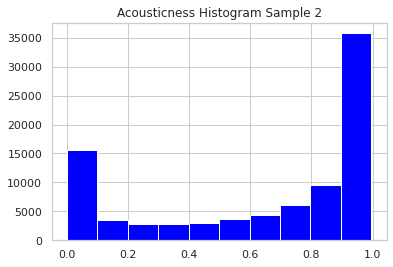

In [ ]:
plot = sample2["acousticness"].hist(color = "blue")
plt.title("Acousticness Histogram Sample 2")
fig = plot.get_figure() 
plt.show()

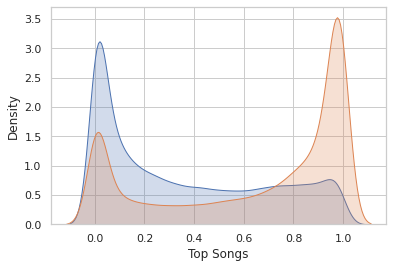

In [ ]:
ax = sns.kdeplot(sample1["acousticness"].rename("Top Songs"), shade=True)
sns.kdeplot(sample2["acousticness"].rename("Others"),  ax=ax, shade=True)
plt.show()

It can be observed that top songs have lower acousticness and others have higher acousticness.
This suggest that acousticness has an effect on popularty. However, we need further test

Let's have t test
**Null Hypothesis ($H_0$)**: Acousticness does not affect popularity.

**Alternative Hypothesis ($H_A$)**: Acousticness affects popularity.

In [ ]:
signifance=0.05
low_ac_group = sample1["acousticness"]
hig_ac_group = sample2["acousticness"]
#ttest_ind if we are comparing means of two independent samples (Two Samples t-Test)
_, p_value = stats.ttest_ind(a=low_ac_group, b=hig_ac_group, equal_var=False)
print("P value: ",format(p_value,".2E"))
print("Signifance value:", signifance)
if (p_value < signifance):
  print("Since p value is smaller than the signigicance value, we reject the null hypothesis. Acousticness affects popularity")
else:
   print("Since p value is larger than the signigicance value,we fail to reject the null hypothesis. Acousticness does not affect popularity.")

P value:  0.00E+00
Signifance value: 0.05
Since p value is smaller than the signigicance value, we reject the null hypothesis. Acousticness affects popularity


**We reject the null hytpothesis. Acousticness affects popularity. The correlation is negative.**

###Popularity vs Energy

**From the pairwise correlation matrix, we know that popularity is positively correlated with energy. We expect songs with high energy to have higher popularity rating.** 

Hypothesis Test: We want to test whether energy of a song affects popularity.

**Null Hypothesis ($H_0$)**: Energy does not affect popularity.

**Alternative Hypothesis ($H_A$)**: Energy affects popularity.

In [ ]:
mean=df['energy'].mean()
sample_mean=sample1['energy'].mean()
std=df['energy'].std()
z_score = (sample_mean- mean) / std
print("Mean of Energy of whole data set ",df['energy'].mean()) 
print("Mean of Energy of sample1 (Higher popularity group)",sample1['energy'].mean()) 
print("Sample1's energy (Higher popularity group) deviate",z_score,"from the whole data set") 

Mean of Energy of whole data set  0.4827208433255605
Mean of Energy of sample1 (Higher popularity group) 0.56598146737875
Sample1's energy (Higher popularity group) deviate 0.3053357446312481 from the whole data set


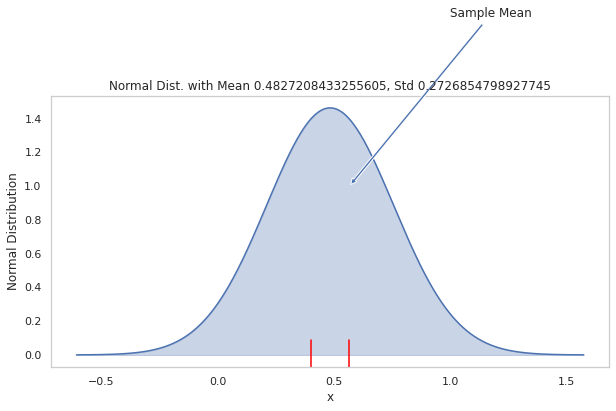

In [ ]:
offset = 4*std
n=df.size

x = np.linspace(mean - offset, mean + offset, n)


y = stats.norm.pdf(x,mean,std)

plt.figure(figsize=(10, 5))
plt.plot(x,y)

plt.grid()
plt.xlabel('x')
plt.ylabel('Normal Distribution')
plt.fill_between(x, y, alpha=0.3, color='b')

plt.axvline(mean - z_score*std, ymax=0.1, color="red")
plt.axvline(mean + z_score*std, ymax=0.1, color="red")

plt.annotate(
    "Sample Mean",
    xy=(mean + z_score*std, 1), 
    xytext=(1, 2), 
    arrowprops={"arrowstyle": "simple"}) 
plt.title('Normal Dist. with Mean {}, Std {}'.format(mean, std))
plt.show()

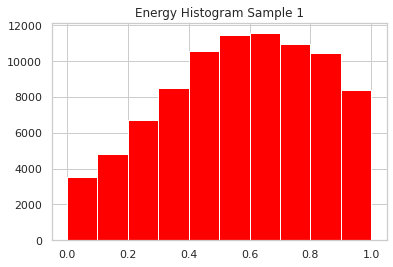

In [ ]:
plot = sample1["energy"].hist(color = "red")
plt.title("Energy Histogram Sample 1")
fig = plot.get_figure() 
plt.show()

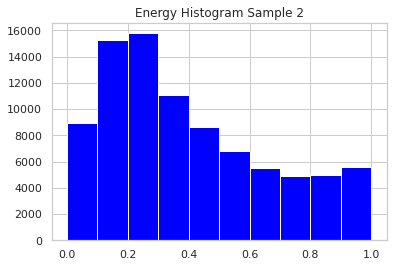

In [ ]:
plot = sample2["energy"].hist(color = "blue")
plt.title("Energy Histogram Sample 2")
fig = plot.get_figure() 
plt.show()

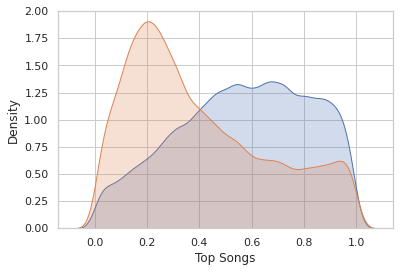

In [ ]:
ax = sns.kdeplot(sample1["energy"].rename("Top Songs"), shade=True)
sns.kdeplot(sample2["energy"].rename("Others"),  ax=ax, shade=True)
plt.show()

**It can be observed that top songs have higher energy and others have lower energy.
This suggest that energy has an effect on popularty. However, we need further test**

**Null Hypothesis ($H_0$)**: Energy does not affect popularity.

**Alternative Hypothesis ($H_A$)**: Energy affects popularity.

In [ ]:
signifance=0.05
high_en_group = sample1["energy"]
low_en_group = sample2["energy"]
#ttest_ind if we are comparing means of two independent samples (Two Samples t-Test)
_, p_value = stats.ttest_ind(a=high_en_group, b=low_en_group, equal_var=False)
print("P value: ",format(p_value,".2E"))
print("Signifance value:", signifance)
if (p_value < signifance):
  print("Since p value is smaller than the signigicance value, we reject the null hypothesis.Energy affects popularity")
else:
   print("Since p value is larger than the signigicance value,we fail to reject the null hypothesis. Energy does not affect popularity.")

P value:  0.00E+00
Signifance value: 0.05
Since p value is smaller than the signigicance value, we reject the null hypothesis.Energy affects popularity


**We reject the null hypothesis, energy affects popularity of a song. The correlation is positive**

###Popularity vs Year

**From the pairwise correlation matrix, we know that popularity is positively correlated with year. It means that latests songs tend to be more popular.** 

**Null Hypothesis ($H_0$)**: Songs release date does not affect popularity.

**Alternative Hypothesis ($H_A$)**: Songs release date affects popularity.

In [ ]:
mean=df['year'].mean()
sample_mean=sample1['year'].mean()
std=df['year'].std()
z_score = (sample_mean- mean) / std
print("Mean of release date of whole data set ",df['year'].mean()) 
print("Mean of release date of sample1 (Higher popularity group)",sample1['year'].mean()) 
print("Sample1's release date (Higher popularity group) deviate",z_score,"from the whole data set") 

Mean of release date of whole data set  1977.0617642167797
Mean of release date of sample1 (Higher popularity group) 1988.8265113712143
Sample1's release date (Higher popularity group) deviate 0.4372219747656682 from the whole data set


Text(0.5, 0, 'Year')

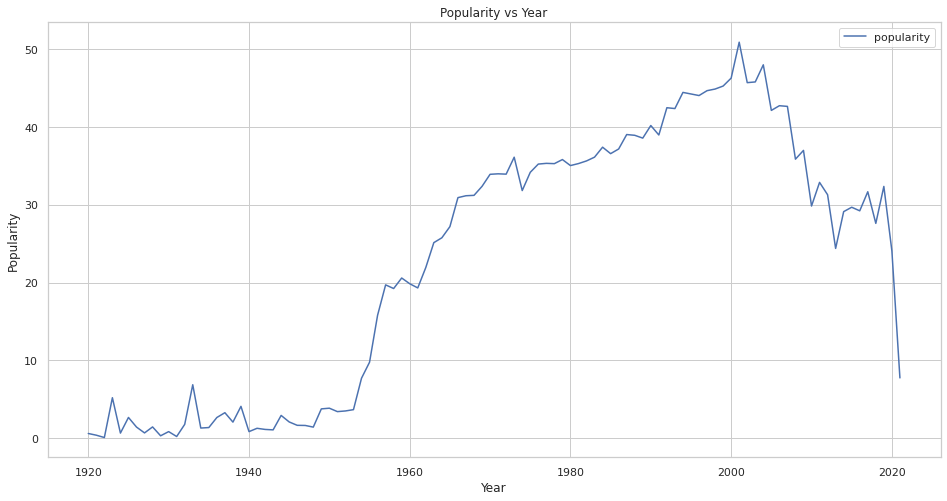

In [ ]:
plt.figure(figsize=(16, 8))
sns.set(style="whitegrid")
columns = ["popularity"]
for col in columns:
    x = df.groupby("year")[col].mean()
    ax= sns.lineplot(x=x.index,y=x,label=col)
ax.set_title('Popularity vs Year')
ax.set_ylabel('Popularity')
ax.set_xlabel('Year')

The time series suggests that old songs popularity is low whilst newer songs popularity is high. Thus release date of a track seem to affect popularity. We need further tests

**Null Hypothesis ($H_0$)**: Songs release date does not affect popularity.

**Alternative Hypothesis ($H_A$)**: Songs release date affects popularity.

In [ ]:
signifance=0.05
popular_group = sample1["year"]
other_group = sample2["year"]
#ttest_ind if we are comparing means of two independent samples (Two Samples t-Test)
_, p_value = stats.ttest_ind(a=popular_group, b=other_group, equal_var=False)
print("P value: ",format(p_value,".2E"))
print("Signifance value:", signifance)
if (p_value < signifance):
  print("Since p value is smaller than the signigicance value, we reject the null hypothesis.Release date affects popularity")
else:
   print("Since p value is larger than the signigicance value,we fail to reject the null hypothesis. Release date does not affect popularity.")

P value:  0.00E+00
Signifance value: 0.05
Since p value is smaller than the signigicance value, we reject the null hypothesis.Release date affects popularity


We reject the null hytpothesis. Release date affects popularity. Older tracks are listened less and the newer tracks are listened more.

##Statistical tests to compare different eras

###Comparing 1950's &1960's with 1970's 1980's

In [ ]:
fifties_sixties=df4[(1950<=df4["year"]) & (df4["year"]<=1969)]
seventies_eigthies=df4[(1970<=df4["year"]) & (df4["year"]<=1989)]

**1950's and 1960's energy and danceability boxplot**

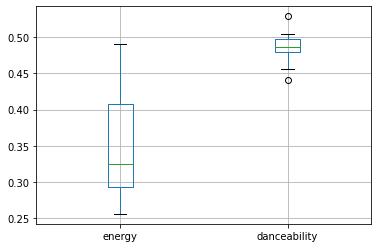

In [ ]:
boxplot = fifties_sixties.boxplot(column=["energy","danceability"])

**1970's and 1980's energy and danceability boxplot**

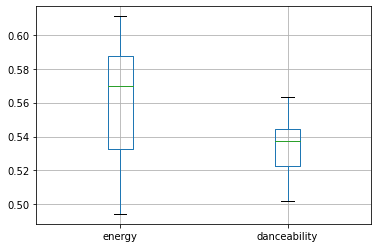

In [ ]:
boxplot = seventies_eigthies.boxplot(column=["energy","danceability"])

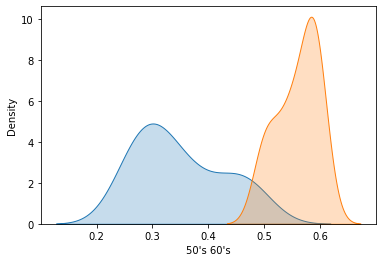

In [ ]:
ax = sns.kdeplot(fifties_sixties["energy"].rename("50's 60's"), shade=True)
sns.kdeplot(seventies_eigthies["energy"].rename("70's 80's"),  ax=ax, shade=True)
plt.show()

**There seems that there is a jump in energies in energy in 1970's and 1980's. Lets apply T-test**

**Null Hypothesis ($H_0$)**: The change in mean of energy is due to chance.

**Alternative Hypothesis ($H_A$)**: The mean of energy in 1950's & 1960's is different than 1970's and 1980's and they are not due to chance.

In [ ]:
signifance=0.05
fif_six = fifties_sixties["energy"]
sev_eig = seventies_eigthies["energy"]
#ttest_ind if we are comparing means of two independent samples (Two Samples t-Test)
_, p_value = stats.ttest_ind(a=fif_six, b=sev_eig, equal_var=False)
print("P value: ",format(p_value,".2E"))
print("Signifance value:", signifance)
if (p_value < signifance):
  print("Since p value is smaller than the signigicance value, we reject the null hypothesis. The mean of energies are different")
else:
   print("Since p value is larger than the signigicance value,we fail to reject the null hypothesis. The differnece in mean of energies are due to chance.")

P value:  1.84E-11
Signifance value: 0.05
Since p value is smaller than the signigicance value, we reject the null hypothesis. The mean of energies are different


**We reject the null hypothesis. The mean of energies are different for 1950's & 1960's and 1970's and 1980's. This jump can be explained with our research: 1970's and 1980's represent departure from the rock & roll and R&B hits of the 50s and 60s.
to disco and disco-funk era, therefore the energy increased.**

###Comparing 1950's and 1960's

In [ ]:
fifties=df4[(1950<=df4["year"]) & (df4["year"]<1960)]
sixties=df4[(1960<=df4["year"]) & (df4["year"]<1970)]

**Acousticness and valence box plot for 1950's**

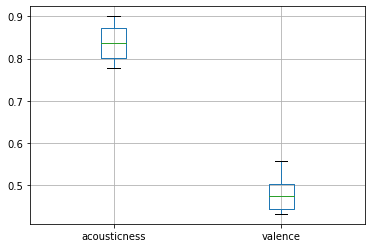

In [ ]:
boxplot = fifties.boxplot(column=["acousticness","valence"])

**Acousticness and valence box plot for 1960's**

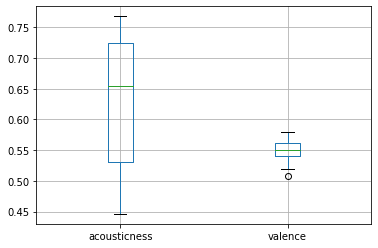

In [ ]:
boxplot = sixties.boxplot(column=["acousticness","valence"])

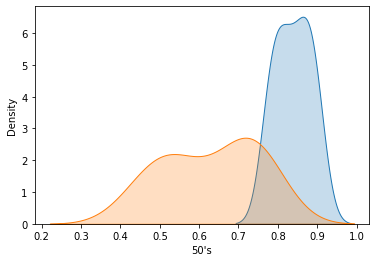

In [ ]:
ax = sns.kdeplot(fifties["acousticness"].rename("50's"), shade=True)
sns.kdeplot(sixties["acousticness"].rename("60's"),  ax=ax, shade=True)
plt.show()

**There seems that there is a drop of acousticness after 1950's. Let's apply T-test**

**Null Hypothesis ($H_0$)**: The change in mean of acousticness is due to chance.

**Alternative Hypothesis ($H_A$)**: The mean of acousticness in 1950's is different than 1960's and they are not due to chance.

In [ ]:
signifance=0.05
fif = fifties["acousticness"]
six = sixties["acousticness"]
#ttest_ind if we are comparing means of two independent samples (Two Samples t-Test)
_, p_value = stats.ttest_ind(a=fif_six, b=sev_eig, equal_var=False)
print("P value: ",format(p_value,".2E"))
print("Signifance value:", signifance)
if (p_value < signifance):
  print("Since p value is smaller than the signigicance value, we reject the null hypothesis. The mean of acousticness are different")
else:
   print("Since p value is larger than the signigicance value,we fail to reject the null hypothesis. The difference in mean of acousticnes are due to chance.")

P value:  1.84E-11
Signifance value: 0.05
Since p value is smaller than the signigicance value, we reject the null hypothesis. The mean of acousticness are different


**We reject the null hypothesis. The difference in mean of acousticnes are not due to chance. This can be explained. From our research: The decrease in acousticness in 1960's can be explained with amplifiers and electric guitars becoming popular in 1960's. Acousticness is a measureument of acoustic means. For example voice and acoustic instruments that are not electronically synthesized.Acousticness decreased in 1960's unsuprisingly with the introduction of electric guitars, distortions, synthesizers and auto-tuned vocals.**

###Analyzing The Change in Rock Genre by comparing 1970's and 1990's

**We have to prepare the data so that we should merge the track data with genre data, then we will obtain track, audio feautures, year and genre**

In [ ]:
data=df
import re
data['artists'] = data['artists'].apply(lambda x: re.findall(r'[\']([\w\s-]+)[\']', x))


In [ ]:
data = data.explode('artists')

In [ ]:
merged = pd.merge(data, df5, on="artists")
merged.columns

Index(['acousticness_x', 'artists', 'danceability_x', 'duration_ms_x',
       'energy_x', 'explicit', 'id', 'instrumentalness_x', 'key_x',
       'liveness_x', 'loudness_x', 'mode_x', 'name', 'popularity_x',
       'release_date', 'speechiness_x', 'tempo_x', 'valence_x', 'year',
       'acousticness_y', 'danceability_y', 'duration_ms_y', 'energy_y',
       'instrumentalness_y', 'liveness_y', 'loudness_y', 'speechiness_y',
       'tempo_y', 'valence_y', 'popularity_y', 'key_y', 'mode_y', 'count',
       'genres'],
      dtype='object')

In [ ]:
merged['genres'] = merged['genres'].apply(lambda x: re.findall(r'[\']([\w\s-]+)[\']', x))

In [ ]:
merged = merged.explode('genres')

**Data is ready, lets seperate the merged dataframe by obtaining 1970's rock and 1990's rock**

In [ ]:
sample_rock = merged[merged.genres == 'rock']
rock_70=sample_rock[(1970<=sample_rock["year"]) & (sample_rock["year"]<=1979)]
rock_90=sample_rock[(1990<=sample_rock["year"]) & (sample_rock["year"]<=1999)]

In [ ]:
rock_70=rock_70.dropna()
rock_90=rock_90.dropna()

**Let's observe acousticness**

In [ ]:
print(rock_70.acousticness_x.mean())
print(rock_90.acousticness_x.mean())

0.29657749859585164
0.13866955561531394


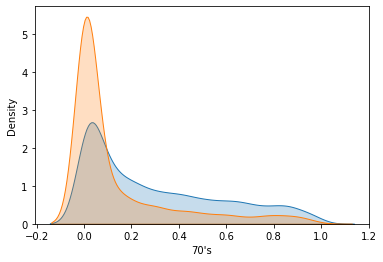

In [ ]:
ax = sns.kdeplot(rock_70["acousticness_x"].rename("70's"), shade=True)
sns.kdeplot(rock_90["acousticness_x"].rename("90's"),  ax=ax, shade=True)
plt.show()

Text(0.5, 0, 'Year')

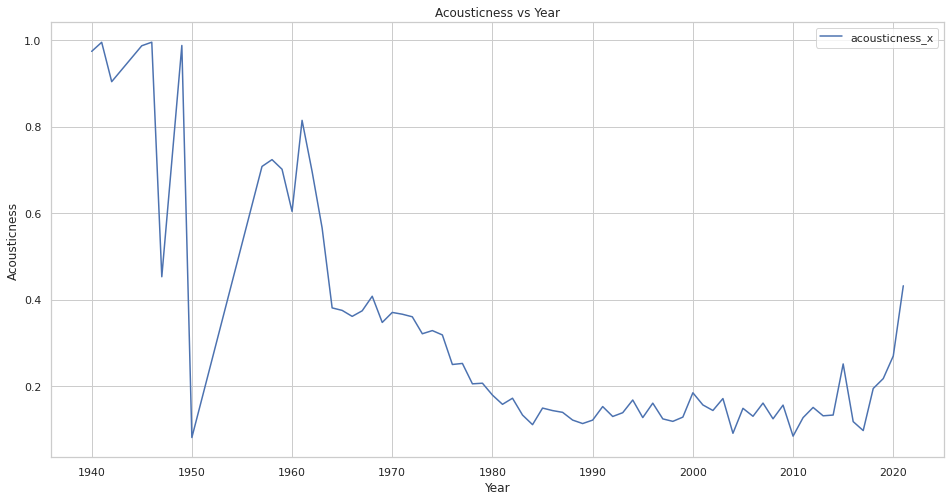

In [ ]:
plt.figure(figsize=(16, 8))
sns.set(style="whitegrid")


x = sample_rock.groupby("year")["acousticness_x"].mean()
ax= sns.lineplot(x=x.index,y=x,label="acousticness_x")
ax.set_title('Acousticness vs Year')
ax.set_ylabel('Acousticness')
ax.set_xlabel('Year')

**We can see the decrease in acousticness in the rock music from 1970's to 1990's. Let's apply statistical tests**

**Null Hypothesis ($H_0$)**: The change in mean of acousticness in rock genre in years 1970's and 1990's are due to chance.

**Alternative Hypothesis ($H_A$)**: The mean of acousticness in 1970's rock & 1990's rock is different they are not due to chance.

In [ ]:
signifance=0.05
sev = rock_70["acousticness_x"]
nin = rock_90["acousticness_x"]
#ttest_ind if we are comparing means of two independent samples (Two Samples t-Test)
_, p_value = stats.ttest_ind(a=sev, b=nin, equal_var=False)
print("P value: ",format(p_value,".2E"))
print("Signifance value:", signifance)
if (p_value < signifance):
  print("Since p value is smaller than the signigicance value, we reject the null hypothesis. The mean of acousticness are different")
else:
   print("Since p value is larger than the signigicance value,we fail to reject the null hypothesis. The differnece in mean of acousticness are due to chance.")

P value:  3.45E-187
Signifance value: 0.05
Since p value is smaller than the signigicance value, we reject the null hypothesis. The mean of acousticness are different


**We accept the alternative hypothesis. The mean of acousticness in 1970's rock & 1990's rock is different they are not due to chance. This can be explained with again amplifiers and electric guitars becoming popular as the technology develops.**

**Let's analyze energy**

In [ ]:
print(rock_70.energy_x.mean())
print(rock_90.energy_x.mean())

0.5956646746076218
0.7167961039805535


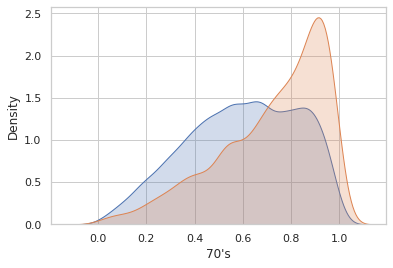

In [ ]:
ax = sns.kdeplot(rock_70["energy_x"].rename("70's"), shade=True)
sns.kdeplot(rock_90["energy_x"].rename("90's"),  ax=ax, shade=True)
plt.show()

**It looks like rock in 1990's were more energetic, let's apply statistical tests**

**Null Hypothesis ($H_0$)**: The change in mean of energys in rock genre in years 1970's and 1990's are due to chance.

**Alternative Hypothesis ($H_A$)**: The mean of energy in 1970's rock & 1990's rock is different they are not due to chance.

In [ ]:
signifance=0.05
sev = rock_70["energy_x"]
nin = rock_90["energy_x"]
#ttest_ind if we are comparing means of two independent samples (Two Samples t-Test)
_, p_value = stats.ttest_ind(a=sev, b=nin, equal_var=False)
print("P value: ",format(p_value,".2E"))
print("Signifance value:", signifance)
if (p_value < signifance):
  print("Since p value is smaller than the signigicance value, we reject the null hypothesis. The mean of energy are different")
else:
   print("Since p value is larger than the signigicance value,we fail to reject the null hypothesis. The differnece in mean of energy are due to chance.")

P value:  5.12E-138
Signifance value: 0.05
Since p value is smaller than the signigicance value, we reject the null hypothesis. The mean of energy are different


**We accept the alternative Hypothesis.The mean of energy in 1970's rock & 1990's rock is different they are not due to chance. This can be explained from our research. Punk rock dominate the era 70's. 
Punk rock was insurrectionist, rebellious , dark and screechy.  It was disdainful of authority and traditions. Examples are The Ramones and the Sex Pistols
On the other hand, alternative rock dominated the era 90's. It was
sentimental and deep. Examples are Nirvana and Red hot Chilli Peppers. Therefore the energy of alternative rock can be higher than punk rock.**

### Technology Affects

In this section we want to see how world wide web(1920) an TV(1950) affacted the music industy (we want to see radio too but since radio invented in 1920 which is begining of our interval. And we couldnt find free data source about radio sales or # of radio listeners)

In [ ]:
nds.head(10)

,genres,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count,year
0,show tunes,"""Cats"" 1981 Original London Cast",0.590111,0.467222,250318.555556,0.394003,0.011400,0.290833,-14.448000,0.210389,117.518111,0.389500,38.333333,5,1,9,1981
8,parody,"""Weird Al"" Yankovic",0.173145,0.662787,218948.196721,0.695393,0.000050,0.161102,-9.768705,0.084536,133.031180,0.751344,34.229508,9,1,122,1990
9,comedy rock,"""Weird Al"" Yankovic",0.173145,0.662787,218948.196721,0.695393,0.000050,0.161102,-9.768705,0.084536,133.031180,0.751344,34.229508,9,1,122,1990
10,comic,"""Weird Al"" Yankovic",0.173145,0.662787,218948.196721,0.695393,0.000050,0.161102,-9.768705,0.084536,133.031180,0.751344,34.229508,9,1,122,1990
11,vapor trap,$NOT,0.544467,0.789800,137910.466667,0.532933,0.023063,0.180300,-9.149267,0.293687,112.344800,0.480700,67.533333,1,1,15,2019
12,emo rap,$NOT,0.544467,0.789800,137910.466667,0.532933,0.023063,0.180300,-9.149267,0.293687,112.344800,0.480700,67.533333,1,1,15,2019
13,florida rap,$NOT,0.544467,0.789800,137910.466667,0.532933,0.023063,0.180300,-9.149267,0.293687,112.344800,0.480700,67.533333,1,1,15,2019
14,sad rap,$NOT,0.544467,0.789800,137910.466667,0.532933,0.023063,0.180300,-9.149267,0.293687,112.344800,0.480700,67.533333,1,1,15,2019
15,underground hip hop,$NOT,0.544467,0.789800,137910.466667,0.532933,0.023063,0.180300,-9.149267,0.293687,112.344800,0.480700,67.533333,1,1,15,2019
16,meme rap,$atori Zoom,0.239000,0.883000,141519.000000,0.625000,0.000000,0.076500,-4.098000,0.245000,126.677000,0.871000,67.000000,6,1,2,2019


In [ ]:
nds["year"] = nds["year"].astype(int)
nds.head()
dda= nds.groupby('year')['genres'].nunique()
dd = dda.to_frame()

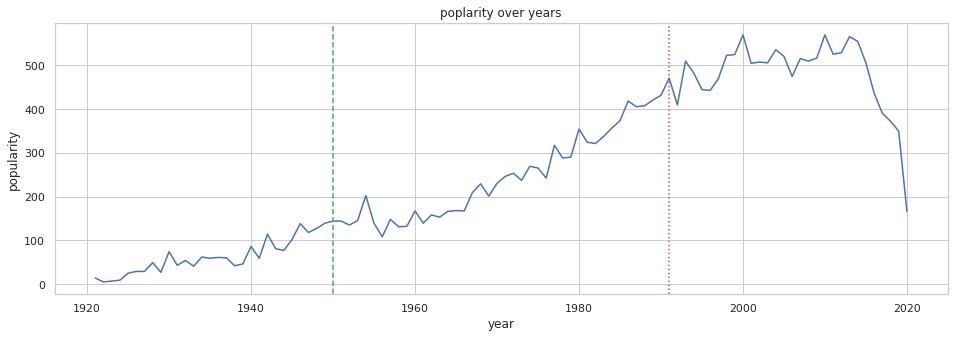

In [ ]:
plt.figure(figsize=(16,5))
plt.plot([i for i in dd["genres"].keys()] , [dd["genres"][i] for i in dd["genres"].keys()])
plt.gca().set(title="poplarity over years", xlabel="year", ylabel="popularity")
plt.axvline(x=1991, color='r', linestyle='dotted', label= "World wide web became avalible for public")
plt.axvline(x=1950, color='g', linestyle='--', label= "TV became avalible for public")
plt.show()

As we can see from chart above invention of TV can be corolated with this huge peak at the graph lets apply some tests to make sure 

In [ ]:
dda= nds.groupby('year')['genres'].nunique()
dd = dda.to_frame()
ll = [i for i in dd["genres"].keys()]
zz = [dd["genres"][i] for i in dd["genres"].keys()]
maxp = max(zz)
for i in range(0,len(ll)):
  if(int(ll[i]) <= 1950):
    ll[i] = "before"
  elif(1950 < int(ll[i]) < 1991):
    ll[i] = "btw"
  else:
    ll[i] = "after" 
h , m = maxp*0.66 , maxp*0.33
for i in range(0,len(zz)):
  if(int(zz[i]) <= m):
    zz[i] = "nonpopular"
  elif(m < int(zz[i]) <= h):
    zz[i] = "mid"
  else:
    zz[i] = "high"

In [ ]:

df = pd.DataFrame(list(zip(ll, zz)),
               columns =['year', 'popu'])

In [ ]:

crosstab_df = pd.crosstab(df["year"], df["popu"])
crosstab_df

popu,high,mid,nonpopular
year,,,
after,27,2,1
before,0,0,30
btw,5,20,15


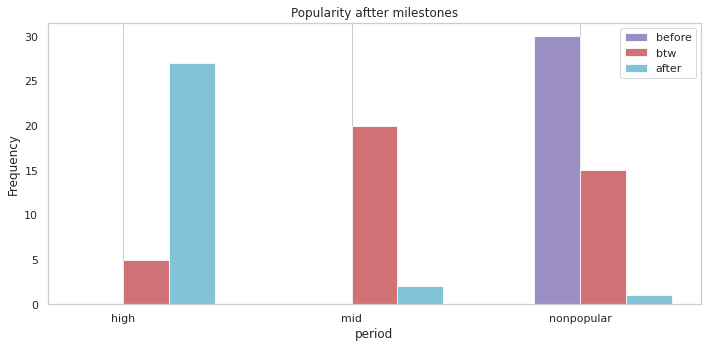

In [ ]:
after  = crosstab_df.loc["after"]
before = crosstab_df.loc["before"]
btw = crosstab_df.loc["btw"]


fig, ax = plt.subplots(1, 1,figsize=(10,5))

index = np.arange(crosstab_df.columns.shape[0])
bar_width = 0.20
opacity = 0.8


rects2 = plt.bar(index, crosstab_df.loc["before"], bar_width,
    alpha=opacity,
    color='m',
    label='before')

rects3 = plt.bar(index + bar_width, crosstab_df.loc["btw"], bar_width,
    alpha=opacity,
    color='r',
    label='btw')

rects1 = plt.bar(index + bar_width*2, crosstab_df.loc["after"], bar_width,
    alpha=opacity,
    color='c',
    label='after')
 



 
plt.ylabel("Frequency")
plt.title("Popularity aftter milestones")
plt.grid(axis="y")
plt.xlabel('period')
plt.xticks(index + (bar_width /2), crosstab_df.columns)
plt.legend()
 
plt.tight_layout()
plt.show()

In [ ]:
alpha = 0.05
chi2_test_stat, p_value, dof, expected_freqs = stats.chi2_contingency(crosstab_df)

if (p_value < alpha): 
  print("Technology and popularity are dependant")

else:
  print("Technology and popularity are not independent")

Technology and popularity are dependant


We think TV had an immense effect on the popularization of the Music Industry maybe music is more entertaining with music videos and combination of TV,radio,WWW caused huge peak in last interval


(additional source: https://www.britannica.com/topic/rock-and-television-1369757)


After reading this article we thought maybe this inovations lead to changes in genres between eras and we deciedto examine rockn roll transformation. We choosed 1950(tv) and 1990(www).

In [ ]:
for i in range(len(arr)):
  if(arr[i].iloc[0]['genres'] == 'rock'):
    newdata = arr[i]

In [ ]:
newdata.head()

,genres,artists,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count
17305,rock,Dino,1930.000000,0.330000,0.795000,229533.000000,0.353000,0.000007,0.314000,-13.682000,0.077700,127.836000,0.756000,0.000000,11.0,0.0,2.0
48186,rock,Orchestra,1940.566667,0.909055,0.417600,211823.745455,0.323993,0.343681,0.299389,-14.265655,0.135387,97.666673,0.381585,5.127273,8.0,1.0,55.0
73555,rock,Yusuf,1946.000000,0.995500,0.621000,197329.000000,0.275500,0.000254,0.245000,-7.410000,0.202500,71.436000,0.585000,0.000000,6.0,1.0,2.0
69189,rock,Totò,1949.000000,0.987667,0.444333,99047.333333,0.271067,0.206329,0.227667,-16.406333,0.087333,77.936667,0.786000,0.000000,6.0,1.0,6.0
21915,rock,Fig,1950.000000,0.081300,0.435500,225433.000000,0.602500,0.000023,0.225500,-9.870000,0.029800,131.959500,0.420500,0.000000,11.0,1.0,4.0


In [ ]:
y = []
p = []
mm = newdata['popularity']
mm = max(mm)
#print(mm)


for i in range(0,len(newdata['year'])):

  if(1960 < int(newdata.iloc[i]['year']) < 1980):
    #newdata.iloc[i]['year'] = "btw"
    y.append("btw")
    if(int(newdata.iloc[i]['popularity']) <= mm/3):
      p.append("low")
    elif(int(newdata.iloc[i]['popularity']) <= ((2*mm)/3)):
      p.append("mid")
    else:
      p.append("high")
  if(1990 < int(newdata.iloc[i]['year']) < 2010):
    #newdata.iloc[i]['year'] = "after" 
    y.append("after")
    if(int(newdata.iloc[i]['popularity']) <= mm/3):
      p.append("low")
    elif(int(newdata.iloc[i]['popularity']) <= ((2*mm)/3)):
      p.append("mid")
    else:
      p.append("high")

74.18181818181819


In [ ]:
newdata.head()

,genres,artists,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count
17305,rock,Dino,1930.000000,0.330000,0.795000,229533.000000,0.353000,0.000007,0.314000,-13.682000,0.077700,127.836000,0.756000,0.000000,11.0,0.0,2.0
48186,rock,Orchestra,1940.566667,0.909055,0.417600,211823.745455,0.323993,0.343681,0.299389,-14.265655,0.135387,97.666673,0.381585,5.127273,8.0,1.0,55.0
73555,rock,Yusuf,1946.000000,0.995500,0.621000,197329.000000,0.275500,0.000254,0.245000,-7.410000,0.202500,71.436000,0.585000,0.000000,6.0,1.0,2.0
69189,rock,Totò,1949.000000,0.987667,0.444333,99047.333333,0.271067,0.206329,0.227667,-16.406333,0.087333,77.936667,0.786000,0.000000,6.0,1.0,6.0
21915,rock,Fig,1950.000000,0.081300,0.435500,225433.000000,0.602500,0.000023,0.225500,-9.870000,0.029800,131.959500,0.420500,0.000000,11.0,1.0,4.0


In [ ]:
df = pd.DataFrame(list(zip(y, p)),
               columns =['year', 'popu'])

In [ ]:
crosstab_df = pd.crosstab(df["year"], df["popu"])
crosstab_df

popu,high,low,mid
year,,,
after,54,0,105
btw,1,3,136


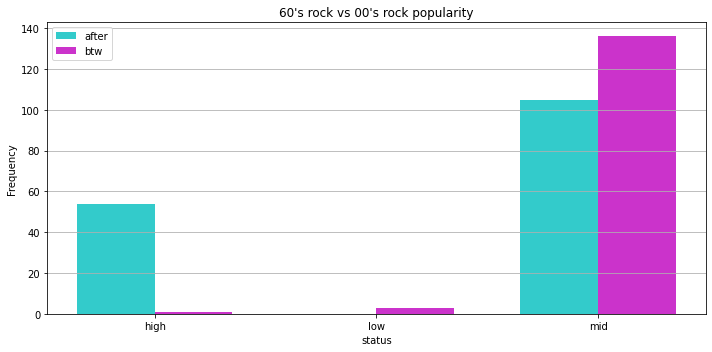

In [ ]:
female = crosstab_df.loc["after"]
male = crosstab_df.loc["btw"]

fig, ax = plt.subplots(1, 1, figsize=(10,5))

index = np.arange(crosstab_df.columns.shape[0])
bar_width = 0.35
opacity = 0.8
 
rects1 = plt.bar(index, crosstab_df.loc["after"], bar_width,
    alpha=opacity,
    color='c',
    label='after')
 
rects2 = plt.bar(index + bar_width, crosstab_df.loc["btw"], bar_width,
    alpha=opacity,
    color='m',
    label='btw')
 
plt.ylabel("Frequency")
plt.title("60's rock vs 00's rock popularity")
plt.grid(axis="y")
plt.xlabel('status')
plt.xticks(index + (bar_width / 2), crosstab_df.columns)
plt.legend()
 
plt.tight_layout()
plt.show()

In [ ]:
from scipy import stats
alpha = 0.05
chi2_test_stat, p_value, dof, expected_freqs = stats.chi2_contingency(crosstab_df)
if (p_value > alpha): 
  print("Technology and popularity are independant")

else:
  print("Technology and popularity are not dependent")


Technology and popularity are not dependent


#Machine Learning

In [ ]:
import ast
import sklearn
from sklearn.utils import shuffle
from sklearn.neighbors import KNeighborsClassifier
import pandas as pd
import numpy as np
from sklearn import linear_model, preprocessing
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
import plotly.express as pe
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE

##Prediction of song popularity with various machine learning models


**Building Models**

###Using Linear Regression

In [46]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

from sklearn import metrics
from sklearn.metrics import confusion_matrix, classification_report


**Prepare the Data for the Model**

In [47]:
df = df.dropna()
df = df[df.notnull()]
df = df.drop_duplicates()

df['release_date'] = df['release_date'].str.slice(0, 4)
df['release_date'] = df['release_date'].astype(int)

del df['id']
del df['name']
del df['artists']

In [ ]:
X= df.loc[:,df.columns!='popularity']
y= df.loc[:,df.columns=='popularity']

sc_X= StandardScaler()
sc_y= StandardScaler()
X=sc_X.fit_transform(X)
y=sc_y.fit_transform(y)

**Splitting to data to three parts; train data, test, validate**

In [48]:
X_train, X_test_valid, y_train, y_test_valid = train_test_split(X,y,test_size=0.20, random_state=0)
x_valid, x_test, y_val, y_test = train_test_split(X_test_valid, y_test_valid, test_size = 0.5, random_state = 0)

In [ ]:
regressor_lin=LinearRegression()
regressor_lin.fit(X_train,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
y_pred_lin = regressor_lin.predict(x_test)

In [ ]:
print('Checking the accuracy of Linear Regression')
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred_lin))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred_lin))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred_lin)))

Checking the accuracy of Linear Regression
Mean Absolute Error: 0.6041158315607807
Mean Squared Error: 0.6240750782685983
Root Mean Squared Error: 0.7899842265948088


In [ ]:
from sklearn.linear_model import Lasso

Lasso_model = Lasso(alpha = 0.001, normalize =False)
Lasso_model.fit(X_train, y_train)
pred_Lasso = Lasso_model.predict(x_valid) 

In [ ]:
from sklearn.linear_model import Ridge

ridge_model = Ridge(alpha = 0.01, normalize = True)
ridge_model.fit(X_train, y_train)             
pred_ridge = ridge_model.predict(x_valid) 

In [ ]:
print('Mean Absolute Error Lasso Regressor:', metrics.mean_absolute_error(y_val, pred_Lasso))
print('Mean Squared Erro Lasso Regressor:', metrics.mean_squared_error(y_val, pred_Lasso))
print('Root Mean Squared Error Lasso Regressor:', np.sqrt(metrics.mean_squared_error(y_val, pred_Lasso)))
print(" ")
print('Mean Absolute Error Ridge Regressor:', metrics.mean_absolute_error(y_val, pred_ridge))
print('Mean Squared Error: Ridge Regressor', metrics.mean_squared_error(y_val, pred_ridge))
print('Root Mean Squared Error Ridge Regressor:', np.sqrt(metrics.mean_squared_error(y_val, pred_ridge)))

Mean Absolute Error Lasso Regressor: 0.6022195765154538
Mean Squared Erro Lasso Regressor: 0.619468244764171
Root Mean Squared Error Lasso Regressor: 0.7870630500564557
 
Mean Absolute Error Ridge Regressor: 0.6023820401035753
Mean Squared Error: Ridge Regressor 0.6194655743831317
Root Mean Squared Error Ridge Regressor: 0.7870613536333312


###Decision Tree

In [45]:
from sklearn import linear_model, preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error as mse
from sklearn.model_selection import train_test_split as split

from sklearn import metrics
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split 
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

In [ ]:
dec_tree = DecisionTreeRegressor(random_state=0)
dec_tree.fit(X_train,  y_train)

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=0, splitter='best')

In [ ]:
val_preds1 = dec_tree.predict(x_test)
print('Checking the accuracy of Decision Tree')
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, val_preds1))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, val_preds1))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test,val_preds1)))

Checking the accuracy of Decision Tree
Mean Absolute Error: 0.4923380985334887
Mean Squared Error: 0.6424406780375278
Root Mean Squared Error: 0.8015239722163822


In [ ]:
grid = GridSearchCV(DecisionTreeRegressor(random_state=0), cv=3, n_jobs=-1, verbose=5,
                    param_grid ={
                    'max_depth': [4,5,6,7,8,9,10,11],
                    'max_features':[n_features//2, n_features//3],
                    'min_samples_split': [2,0.3,0.5, n_samples//2, n_samples//3, n_samples//5],
                    'min_samples_leaf':[1, 0.3,0.5, n_samples//2, n_samples//3, n_samples//5]},
                    )
 
grid.fit(X_train, y_train)
print('Best Parameters : ',grid.best_params_)



Fitting 3 folds for each of 576 candidates, totalling 1728 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 40 concurrent workers.
[Parallel(n_jobs=-1)]: Done  82 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 208 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 370 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:    4.5s
[Parallel(n_jobs=-1)]: Done 802 tasks      | elapsed:    5.8s
[Parallel(n_jobs=-1)]: Done 1072 tasks      | elapsed:    7.3s
[Parallel(n_jobs=-1)]: Done 1378 tasks      | elapsed:    9.0s
[Parallel(n_jobs=-1)]: Done 1728 out of 1728 | elapsed:   10.9s finished


Best Parameters :  {'max_depth': 11, 'max_features': 8, 'min_samples_leaf': 1, 'min_samples_split': 2}


In [ ]:
decision_tree2 = DecisionTreeRegressor(max_depth=11, max_features=None, 
                                  min_samples_leaf=1, min_samples_split=2, random_state=0)
decision_tree2.fit(X_train, y_train)
value_preds2 = decision_tree2.predict(x_valid)
print('Checking the accuracy of Decision Tree with Best Parameters')
print('Mean Absolute Error:', metrics.mean_absolute_error(y_val, value_preds2))
print('Mean Squared Error:', metrics.mean_squared_error(y_val, value_preds2))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_val, value_preds2)))

Checking the accuracy of Decision Tree with Best Parameters
Mean Absolute Error: 0.39998215279305865
Mean Squared Error: 0.38456988377663687
Root Mean Squared Error: 0.6201369879120555


###Random Forest

In [56]:
from sklearn import tree
from sklearn.ensemble import RandomForestRegressor

In [ ]:
rand_forest = RandomForestRegressor(n_estimators=100, random_state=42)
rand_forest.fit(X_train, y_train.ravel()) 

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=False,
                      random_state=42, verbose=0, warm_start=False)

In [ ]:
val_preds2 = rand_forest.predict(x_test)
print('Checking the accuracy of Random Forest')
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, val_preds2))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, val_preds2))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test,val_preds2)))

Checking the accuracy of Random Forest
Mean Absolute Error: 0.3777403998737216
Mean Squared Error: 0.3176578890843106
Root Mean Squared Error: 0.5636114699722767


In [51]:
param_grid = {
    'bootstrap': [True],
    'max_depth': [80, 90, 100],
    'max_features': [2, 3],
    'min_samples_leaf': [3, 4, 5],
    'min_samples_split': [8, 10, 12],
    'n_estimators': [100]
}

grid_search = GridSearchCV(RandomForestRegressor(n_estimators=100,random_state=0),param_grid = param_grid, 
                           cv = 2, n_jobs = -1, verbose = 2)

In [53]:
grid_search.fit(X_train, y_train.ravel())
grid_search.best_params_

Fitting 2 folds for each of 54 candidates, totalling 108 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 40 concurrent workers.
[Parallel(n_jobs=-1)]: Done  84 out of 108 | elapsed:  1.1min remaining:   18.9s
[Parallel(n_jobs=-1)]: Done 108 out of 108 | elapsed:  1.3min finished


{'bootstrap': True,
 'max_depth': 80,
 'max_features': 3,
 'min_samples_leaf': 3,
 'min_samples_split': 8,
 'n_estimators': 100}

In [59]:
rand_forest2 = RandomForestRegressor(max_depth=80, max_features=3, 
                                  min_samples_leaf=3, min_samples_split=8, n_estimators=100)
rand_forest2.fit(X_train, y_train.ravel())
value_preds3 = rand_forest2.predict(x_valid)
print('Checking the accuracy of Random Forest with Best Parameters')
print('Mean Absolute Error:', metrics.mean_absolute_error(y_val, value_preds3))
print('Mean Squared Error:', metrics.mean_squared_error(y_val, value_preds3))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_val, value_preds3)))

Checking the accuracy of Random Forest with Best Parameters
Mean Absolute Error: 0.3803275980032215
Mean Squared Error: 0.3177496957871293
Root Mean Squared Error: 0.5636929091155302


**Best Model was Random Forest Regressor for predicting Song Popularity**

In [ ]:
!pip install yellowbrick --upgrade

     |████████████████████████████████| 276kB 6.9MB/s 
  Found existing installation: yellowbrick 0.9.1
    Uninstalling yellowbrick-0.9.1:
      Successfully uninstalled yellowbrick-0.9.1


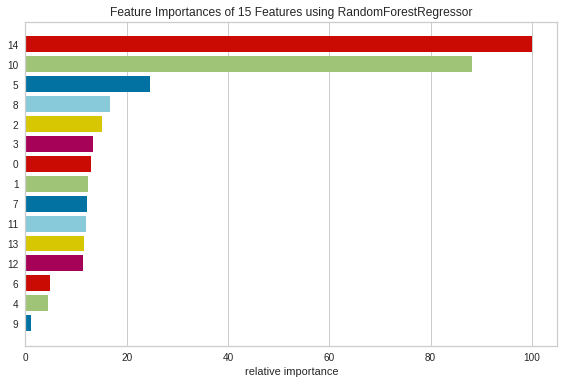

In [ ]:
from yellowbrick.model_selection import FeatureImportances
model = RandomForestRegressor()
viz = FeatureImportances(model)
viz.fit(X_train, y_train.ravel())
viz.show()

##Song recommendation

In [ ]:
f= "data_o.csv"  
path = "./drive/My Drive/CS210ProjectDatas"
data = pd.read_csv(join(path, f))
data = data.drop_duplicates()
data = data.dropna()
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=40,  verbose=2, n_jobs=4))],verbose=True)
X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels
pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
town = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
town['title'] = data['name']
town['cluster'] = data['cluster_label']

fig = pe.scatter(
    town, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.1s
[Pipeline] ............ (step 2 of 2) Processing kmeans, total=  30.3s


In [ ]:
#
import numpy as np
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances_argmin_min
def find_me(song_name):
  index = town.index[town['title'] == song_name].tolist()[0]
  b = town.iloc[[index]]
  b= b.loc[:,b.columns!='title']
  X= town.loc[:,town.columns!='title']
  X = X.drop(index)
  km = KMeans(n_clusters=10).fit(X)
  closest, _ = pairwise_distances_argmin_min(b, X , metric='cosine')
  a = town.iloc[[closest[0]]].values.tolist()

  display(a[0][2])


In [ ]:
input_Song=['Lovers Rock','Riding with the King','Come As You Are']
for i in input_Song:
  find_me(i)

'Demon'

"I'm Not Racist"

'Season of the Witch'